<h2> Deep convolutional GAN</h2>

Projecte adaptat de: https://github.com/davidADSP/Generative_Deep_Learning_2nd_Edition/tree/main

In [129]:
%load_ext tensorboard

import numpy as np
import datetime
import matplotlib.pyplot as plt
import os

import tensorflow as tf
from tensorflow.keras import (
    layers,
    models,
    callbacks,
    losses,
    utils,
    metrics,
    optimizers,
)



from utils import display, sample_batch

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [131]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
tf.config.list_physical_devices('GPU')
#device_name = tf.test.gpu_device_name()


Num GPUs Available:  1


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

<h2> Parameters <h2>

In [275]:
IMAGE_SIZE = 64
CHANNELS = 1
BATCH_SIZE = 64
Z_DIM = 100
EPOCHS = 300
LOAD_MODEL = False
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.999
LEARNING_RATE_G = 0.0002
LEARNING_RATE_D = 0.00005
NOISE_PARAM = 0.1

<h2> Data prepraration <h2>

In [276]:
train_data = utils.image_dataset_from_directory(
    "data/mapSet/",
    labels=None,
    color_mode="grayscale",
    image_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=40,
    interpolation="nearest",
)

Found 4997 files belonging to 1 classes.


In [277]:
def preprocess(img):
    # Normalize and reshape images
    img = (tf.cast(img, "float32") - 127.5) / 127.5
    return img

train = train_data.map(lambda x: preprocess(x))

In [278]:
train_sample = sample_batch(train)

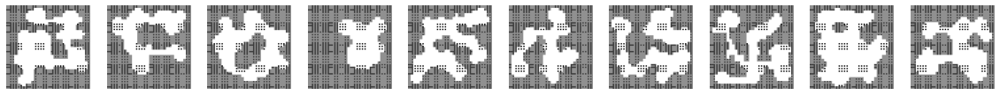

In [279]:
display(train_sample)

<h2> Build the GAN</h2>

In [280]:
discriminator_input = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS))

x = layers.Conv2D(
    64,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False)(discriminator_input)

x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.45)(x)
x = layers.Conv2D(
    128,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False
)(x)

x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.45)(x)
x = layers.Conv2D(
    256,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False
)(x)

x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.45)(x)

x = layers.Conv2D(
    512,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.45)(x)
x = layers.Conv2D(
    1,
    kernel_size=4,
    strides=1,
    padding="valid",
    use_bias=False,
    activation="sigmoid",
)(x)
discriminator_output = layers.Flatten()(x)

discriminator = models.Model(discriminator_input, discriminator_output)
discriminator.summary()

Model: "model_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_43 (InputLayer)       [(None, 64, 64, 1)]       0         
                                                                 
 conv2d_105 (Conv2D)         (None, 32, 32, 64)        1024      
                                                                 
 leaky_re_lu_168 (LeakyReLU)  (None, 32, 32, 64)       0         
                                                                 
 dropout_84 (Dropout)        (None, 32, 32, 64)        0         
                                                                 
 conv2d_106 (Conv2D)         (None, 16, 16, 128)       131072    
                                                                 
 batch_normalization_147 (Ba  (None, 16, 16, 128)      512       
 tchNormalization)                                               
                                                          

In [281]:
generator_input = layers.Input(shape=(Z_DIM,))
x = layers.Reshape((1, 1, Z_DIM))(generator_input)
x = layers.Conv2DTranspose(
    512,
    kernel_size=4,
    strides=1,
    padding="valid",
    use_bias=False
)(x)

x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    256,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False
)(x)

x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)

x = layers.Conv2DTranspose(
    128,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False
)(x)

x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)

x = layers.Conv2DTranspose(
    64,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False
)(x)

x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)

generator_output = layers.Conv2DTranspose(
    CHANNELS,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False,
    activation="tanh",
)(x)

generator = models.Model(generator_input, generator_output)
generator.summary()

Model: "model_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_44 (InputLayer)       [(None, 100)]             0         
                                                                 
 reshape_21 (Reshape)        (None, 1, 1, 100)         0         
                                                                 
 conv2d_transpose_105 (Conv2  (None, 4, 4, 512)        819200    
 DTranspose)                                                     
                                                                 
 batch_normalization_150 (Ba  (None, 4, 4, 512)        2048      
 tchNormalization)                                               
                                                                 
 leaky_re_lu_172 (LeakyReLU)  (None, 4, 4, 512)        0         
                                                                 
 conv2d_transpose_106 (Conv2  (None, 8, 8, 256)        209

In [282]:
class DCGAN(models.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(DCGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, d_optimizer, g_optimizer):
        super(DCGAN, self).compile()
        self.loss_fn = losses.BinaryCrossentropy()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.d_loss_metric = metrics.Mean(name="d_loss")
        self.d_real_acc_metric = metrics.BinaryAccuracy(name="d_real_acc")
        self.d_fake_acc_metric = metrics.BinaryAccuracy(name="d_fake_acc")
        self.d_acc_metric = metrics.BinaryAccuracy(name="d_acc")
        self.g_loss_metric = metrics.Mean(name="g_loss")
        self.g_acc_metric = metrics.BinaryAccuracy(name="g_acc")

    @property
    def metrics(self):
        return [
            self.d_loss_metric,
            self.d_real_acc_metric,
            self.d_fake_acc_metric,
            self.d_acc_metric,
            self.g_loss_metric,
            self.g_acc_metric,
        ]

    def train_step(self, real_images):
        # Sample random points in the latent space
        batch_size = tf.shape(real_images)[0]
        random_latent_vectors = tf.random.normal(
            shape=(batch_size, self.latent_dim)
        )

        # Train the discriminator on fake images
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            generated_images = self.generator(
                random_latent_vectors, training=True
            )
            real_predictions = self.discriminator(real_images, training=True)
            fake_predictions = self.discriminator(
                generated_images, training=True
            )

            real_labels = tf.ones_like(real_predictions)
            real_noisy_labels = real_labels + NOISE_PARAM * tf.random.uniform(
                tf.shape(real_predictions)
            )
            fake_labels = tf.zeros_like(fake_predictions)
            fake_noisy_labels = fake_labels - NOISE_PARAM * tf.random.uniform(
                tf.shape(fake_predictions)
            )

            d_real_loss = self.loss_fn(real_noisy_labels, real_predictions)
            d_fake_loss = self.loss_fn(fake_noisy_labels, fake_predictions)
            d_loss = (d_real_loss + d_fake_loss) / 2.0

            g_loss = self.loss_fn(real_labels, fake_predictions)

        gradients_of_discriminator = disc_tape.gradient(
            d_loss, self.discriminator.trainable_variables
        )
        gradients_of_generator = gen_tape.gradient(
            g_loss, self.generator.trainable_variables
        )

        self.d_optimizer.apply_gradients(
            zip(gradients_of_discriminator, discriminator.trainable_variables)
        )
        self.g_optimizer.apply_gradients(
            zip(gradients_of_generator, generator.trainable_variables)
        )

        # Update metrics
        self.d_loss_metric.update_state(d_loss)
        self.d_real_acc_metric.update_state(real_labels, real_predictions)
        self.d_fake_acc_metric.update_state(fake_labels, fake_predictions)
        self.d_acc_metric.update_state(
            [real_labels, fake_labels], [real_predictions, fake_predictions]
        )
        self.g_loss_metric.update_state(g_loss)
        self.g_acc_metric.update_state(real_labels, fake_predictions)

        return {m.name: m.result() for m in self.metrics}

In [283]:
# Create a DCGAN
dcgan = DCGAN(
    discriminator=discriminator, generator=generator, latent_dim=Z_DIM
)


In [284]:
if LOAD_MODEL:
    dcgan.load_weights("./checkpoint/checkpoint.ckpt")

<h2>Train the GAN</h2>

In [285]:
dcgan.compile(
    d_optimizer=optimizers.Adam(
        learning_rate=LEARNING_RATE_D, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
    ),
    g_optimizer=optimizers.Adam(
        learning_rate=LEARNING_RATE_G, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
    ),
)

In [286]:
# Create a model save checkpoint
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img, latent_dim):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(
            shape=(self.num_img, self.latent_dim)
        )
        generated_images = self.model.generator(random_latent_vectors)
        generated_images = generated_images * 127.5 + 127.5
        generated_images = generated_images.numpy()
        display(
            generated_images,
            save_to="output/generated_img_%03d.png" % (epoch),
        )

Epoch 1/300
 6/79 [=>............................] - ETA: 3s - d_loss: 0.8642 - d_real_acc: 0.5000 - d_fake_acc: 0.5156 - d_acc: 0.5078 - g_loss: 0.8976 - g_acc: 0.4844WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0294s vs `on_train_batch_end` time: 0.0308s). Check your callbacks.


78/79 [============================>.] - ETA: 0s - d_loss: 0.4962 - d_real_acc: 0.7566 - d_fake_acc: 0.6913 - d_acc: 0.7240 - g_loss: 1.3069 - g_acc: 0.3087
Saved to output/generated_img_000.png


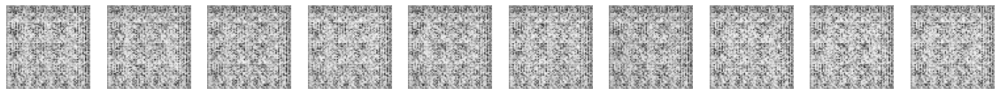

79/79 [==============================] - 7s 57ms/step - d_loss: 0.4916 - d_real_acc: 0.7569 - d_fake_acc: 0.6916 - d_acc: 0.7242 - g_loss: 1.3166 - g_acc: 0.3084
Epoch 2/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.8014 - d_real_acc: 0.5513 - d_fake_acc: 0.5493 - d_acc: 0.5503 - g_loss: 1.0770 - g_acc: 0.4507
Saved to output/generated_img_001.png


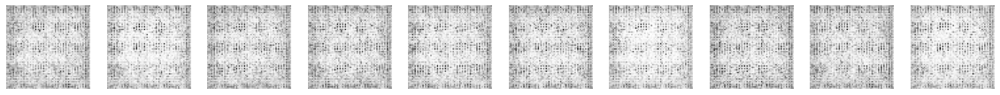

79/79 [==============================] - 4s 50ms/step - d_loss: 0.7995 - d_real_acc: 0.5515 - d_fake_acc: 0.5489 - d_acc: 0.5502 - g_loss: 1.0732 - g_acc: 0.4511
Epoch 3/300
77/79 [============================>.] - ETA: 0s - d_loss: 0.8232 - d_real_acc: 0.5221 - d_fake_acc: 0.5349 - d_acc: 0.5285 - g_loss: 0.9414 - g_acc: 0.4651
Saved to output/generated_img_002.png


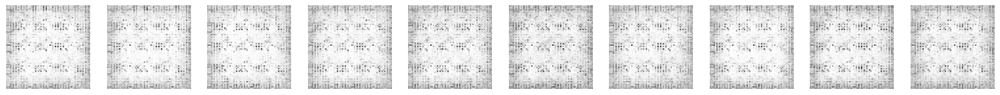

79/79 [==============================] - 4s 49ms/step - d_loss: 0.8204 - d_real_acc: 0.5213 - d_fake_acc: 0.5365 - d_acc: 0.5289 - g_loss: 0.9449 - g_acc: 0.4635
Epoch 4/300
79/79 [==============================] - ETA: 0s - d_loss: 0.6640 - d_real_acc: 0.6246 - d_fake_acc: 0.6226 - d_acc: 0.6236 - g_loss: 1.1105 - g_acc: 0.3774
Saved to output/generated_img_003.png


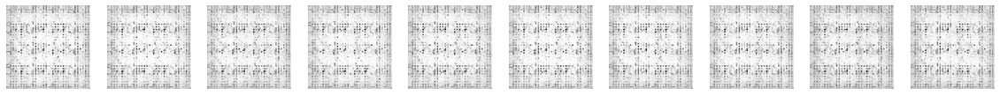

79/79 [==============================] - 4s 50ms/step - d_loss: 0.6640 - d_real_acc: 0.6246 - d_fake_acc: 0.6226 - d_acc: 0.6236 - g_loss: 1.1105 - g_acc: 0.3774
Epoch 5/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.5593 - d_real_acc: 0.6879 - d_fake_acc: 0.6977 - d_acc: 0.6928 - g_loss: 1.2955 - g_acc: 0.3023
Saved to output/generated_img_004.png


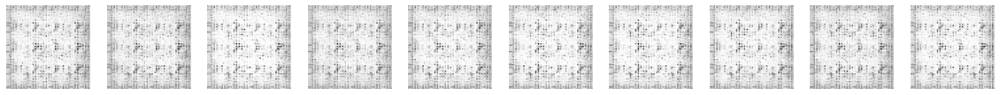

79/79 [==============================] - 4s 50ms/step - d_loss: 0.5604 - d_real_acc: 0.6878 - d_fake_acc: 0.6974 - d_acc: 0.6926 - g_loss: 1.2945 - g_acc: 0.3026
Epoch 6/300
79/79 [==============================] - ETA: 0s - d_loss: 0.3975 - d_real_acc: 0.7705 - d_fake_acc: 0.7843 - d_acc: 0.7774 - g_loss: 1.5982 - g_acc: 0.2157
Saved to output/generated_img_005.png


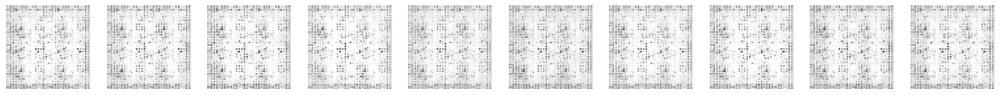

79/79 [==============================] - 4s 49ms/step - d_loss: 0.3975 - d_real_acc: 0.7705 - d_fake_acc: 0.7843 - d_acc: 0.7774 - g_loss: 1.5982 - g_acc: 0.2157
Epoch 7/300
77/79 [============================>.] - ETA: 0s - d_loss: 0.3357 - d_real_acc: 0.7971 - d_fake_acc: 0.8216 - d_acc: 0.8094 - g_loss: 1.8376 - g_acc: 0.1784
Saved to output/generated_img_006.png


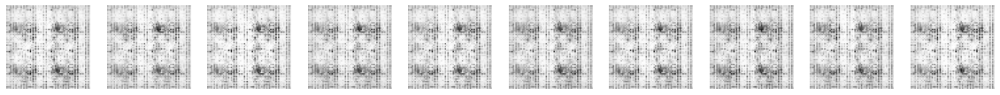

79/79 [==============================] - 4s 50ms/step - d_loss: 0.3371 - d_real_acc: 0.7981 - d_fake_acc: 0.8213 - d_acc: 0.8097 - g_loss: 1.8457 - g_acc: 0.1787
Epoch 8/300
79/79 [==============================] - ETA: 0s - d_loss: 0.2397 - d_real_acc: 0.8407 - d_fake_acc: 0.8643 - d_acc: 0.8525 - g_loss: 2.1645 - g_acc: 0.1357
Saved to output/generated_img_007.png


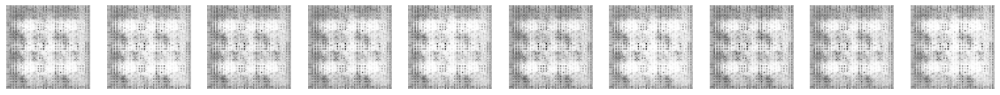

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2397 - d_real_acc: 0.8407 - d_fake_acc: 0.8643 - d_acc: 0.8525 - g_loss: 2.1645 - g_acc: 0.1357
Epoch 9/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.2159 - d_real_acc: 0.8488 - d_fake_acc: 0.8754 - d_acc: 0.8621 - g_loss: 2.3248 - g_acc: 0.1246
Saved to output/generated_img_008.png


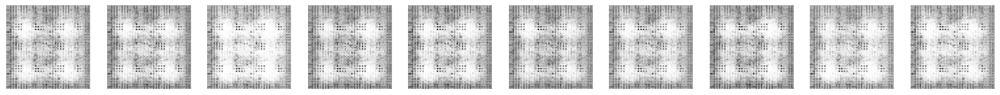

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2183 - d_real_acc: 0.8487 - d_fake_acc: 0.8751 - d_acc: 0.8619 - g_loss: 2.3111 - g_acc: 0.1249
Epoch 10/300
79/79 [==============================] - ETA: 0s - d_loss: 0.5143 - d_real_acc: 0.7284 - d_fake_acc: 0.7260 - d_acc: 0.7272 - g_loss: 1.7014 - g_acc: 0.2740
Saved to output/generated_img_009.png


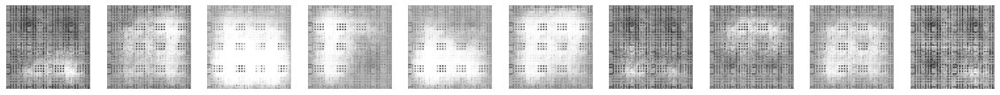

79/79 [==============================] - 4s 50ms/step - d_loss: 0.5143 - d_real_acc: 0.7284 - d_fake_acc: 0.7260 - d_acc: 0.7272 - g_loss: 1.7014 - g_acc: 0.2740
Epoch 11/300
79/79 [==============================] - ETA: 0s - d_loss: 0.4790 - d_real_acc: 0.7408 - d_fake_acc: 0.7448 - d_acc: 0.7428 - g_loss: 1.4902 - g_acc: 0.2552
Saved to output/generated_img_010.png


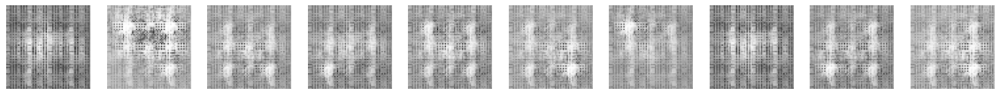

79/79 [==============================] - 4s 50ms/step - d_loss: 0.4790 - d_real_acc: 0.7408 - d_fake_acc: 0.7448 - d_acc: 0.7428 - g_loss: 1.4902 - g_acc: 0.2552
Epoch 12/300
79/79 [==============================] - ETA: 0s - d_loss: 0.3673 - d_real_acc: 0.7861 - d_fake_acc: 0.7995 - d_acc: 0.7928 - g_loss: 1.7454 - g_acc: 0.2005
Saved to output/generated_img_011.png


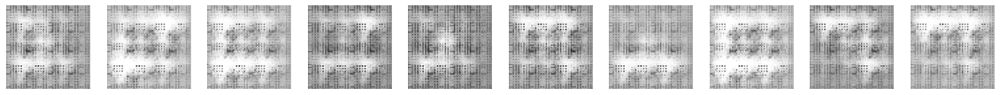

79/79 [==============================] - 4s 50ms/step - d_loss: 0.3673 - d_real_acc: 0.7861 - d_fake_acc: 0.7995 - d_acc: 0.7928 - g_loss: 1.7454 - g_acc: 0.2005
Epoch 13/300
79/79 [==============================] - ETA: 0s - d_loss: 0.3890 - d_real_acc: 0.7857 - d_fake_acc: 0.7885 - d_acc: 0.7871 - g_loss: 1.7570 - g_acc: 0.2115
Saved to output/generated_img_012.png


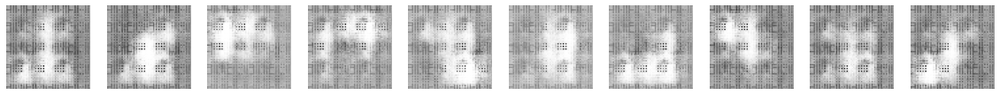

79/79 [==============================] - 5s 57ms/step - d_loss: 0.3890 - d_real_acc: 0.7857 - d_fake_acc: 0.7885 - d_acc: 0.7871 - g_loss: 1.7570 - g_acc: 0.2115
Epoch 14/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.4756 - d_real_acc: 0.7408 - d_fake_acc: 0.7428 - d_acc: 0.7418 - g_loss: 1.5799 - g_acc: 0.2572
Saved to output/generated_img_013.png


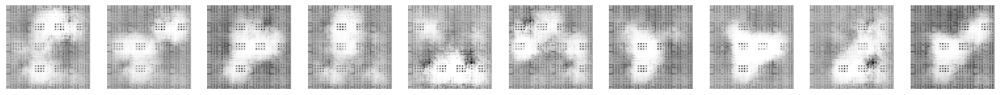

79/79 [==============================] - 4s 52ms/step - d_loss: 0.4785 - d_real_acc: 0.7406 - d_fake_acc: 0.7428 - d_acc: 0.7417 - g_loss: 1.5761 - g_acc: 0.2572
Epoch 15/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.5825 - d_real_acc: 0.6877 - d_fake_acc: 0.6827 - d_acc: 0.6852 - g_loss: 1.3955 - g_acc: 0.3173
Saved to output/generated_img_014.png


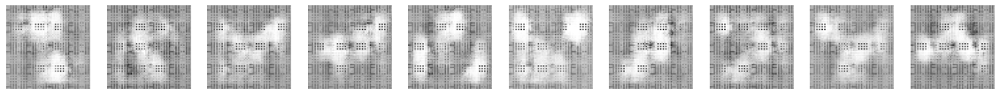

79/79 [==============================] - 4s 50ms/step - d_loss: 0.5870 - d_real_acc: 0.6876 - d_fake_acc: 0.6826 - d_acc: 0.6851 - g_loss: 1.3900 - g_acc: 0.3174
Epoch 16/300
77/79 [============================>.] - ETA: 0s - d_loss: 0.5157 - d_real_acc: 0.7202 - d_fake_acc: 0.7165 - d_acc: 0.7183 - g_loss: 1.5104 - g_acc: 0.2835
Saved to output/generated_img_015.png


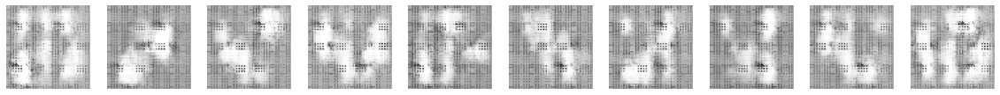

79/79 [==============================] - 4s 50ms/step - d_loss: 0.5141 - d_real_acc: 0.7196 - d_fake_acc: 0.7168 - d_acc: 0.7182 - g_loss: 1.5107 - g_acc: 0.2832
Epoch 17/300
79/79 [==============================] - ETA: 0s - d_loss: 0.4593 - d_real_acc: 0.7547 - d_fake_acc: 0.7498 - d_acc: 0.7523 - g_loss: 1.6654 - g_acc: 0.2502
Saved to output/generated_img_016.png


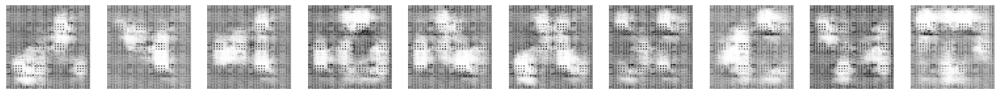

79/79 [==============================] - 4s 50ms/step - d_loss: 0.4593 - d_real_acc: 0.7547 - d_fake_acc: 0.7498 - d_acc: 0.7523 - g_loss: 1.6654 - g_acc: 0.2502
Epoch 18/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.4831 - d_real_acc: 0.7442 - d_fake_acc: 0.7350 - d_acc: 0.7396 - g_loss: 1.5671 - g_acc: 0.2650
Saved to output/generated_img_017.png


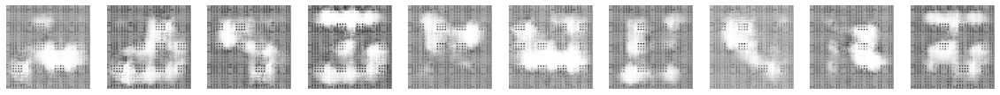

79/79 [==============================] - 4s 50ms/step - d_loss: 0.4902 - d_real_acc: 0.7438 - d_fake_acc: 0.7348 - d_acc: 0.7393 - g_loss: 1.5556 - g_acc: 0.2652
Epoch 19/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.4393 - d_real_acc: 0.7526 - d_fake_acc: 0.7624 - d_acc: 0.7575 - g_loss: 1.6492 - g_acc: 0.2376
Saved to output/generated_img_018.png


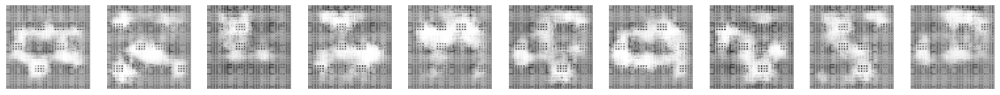

79/79 [==============================] - 4s 49ms/step - d_loss: 0.4382 - d_real_acc: 0.7527 - d_fake_acc: 0.7625 - d_acc: 0.7576 - g_loss: 1.6486 - g_acc: 0.2375
Epoch 20/300
79/79 [==============================] - ETA: 0s - d_loss: 0.4169 - d_real_acc: 0.7789 - d_fake_acc: 0.7693 - d_acc: 0.7741 - g_loss: 1.7074 - g_acc: 0.2307
Saved to output/generated_img_019.png


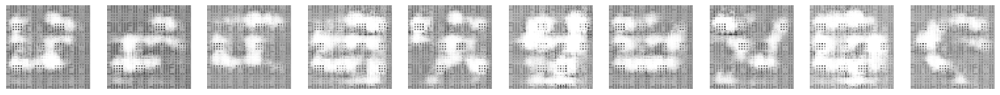

79/79 [==============================] - 4s 50ms/step - d_loss: 0.4169 - d_real_acc: 0.7789 - d_fake_acc: 0.7693 - d_acc: 0.7741 - g_loss: 1.7074 - g_acc: 0.2307
Epoch 21/300
79/79 [==============================] - ETA: 0s - d_loss: 0.3820 - d_real_acc: 0.7917 - d_fake_acc: 0.7905 - d_acc: 0.7911 - g_loss: 1.8146 - g_acc: 0.2095
Saved to output/generated_img_020.png


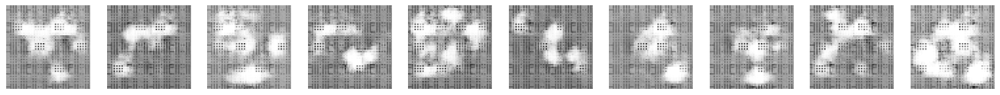

79/79 [==============================] - 4s 50ms/step - d_loss: 0.3820 - d_real_acc: 0.7917 - d_fake_acc: 0.7905 - d_acc: 0.7911 - g_loss: 1.8146 - g_acc: 0.2095
Epoch 22/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.3510 - d_real_acc: 0.8073 - d_fake_acc: 0.8043 - d_acc: 0.8058 - g_loss: 1.9239 - g_acc: 0.1957
Saved to output/generated_img_021.png


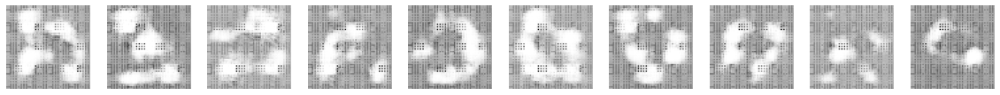

79/79 [==============================] - 4s 50ms/step - d_loss: 0.3555 - d_real_acc: 0.8071 - d_fake_acc: 0.8041 - d_acc: 0.8056 - g_loss: 1.9322 - g_acc: 0.1959
Epoch 23/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.3427 - d_real_acc: 0.8073 - d_fake_acc: 0.8065 - d_acc: 0.8069 - g_loss: 1.9218 - g_acc: 0.1935
Saved to output/generated_img_022.png


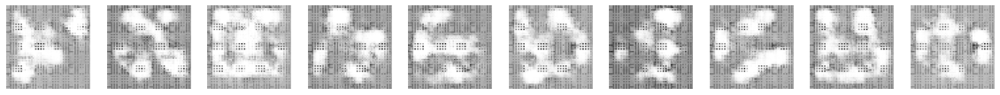

79/79 [==============================] - 4s 50ms/step - d_loss: 0.3454 - d_real_acc: 0.8069 - d_fake_acc: 0.8065 - d_acc: 0.8067 - g_loss: 1.9206 - g_acc: 0.1935
Epoch 24/300
79/79 [==============================] - ETA: 0s - d_loss: 0.3403 - d_real_acc: 0.8105 - d_fake_acc: 0.8063 - d_acc: 0.8084 - g_loss: 2.0208 - g_acc: 0.1937
Saved to output/generated_img_023.png


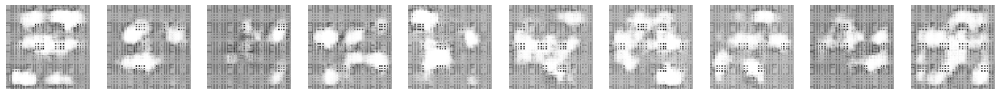

79/79 [==============================] - 4s 51ms/step - d_loss: 0.3403 - d_real_acc: 0.8105 - d_fake_acc: 0.8063 - d_acc: 0.8084 - g_loss: 2.0208 - g_acc: 0.1937
Epoch 25/300
79/79 [==============================] - ETA: 0s - d_loss: 0.3049 - d_real_acc: 0.8319 - d_fake_acc: 0.8195 - d_acc: 0.8257 - g_loss: 2.1065 - g_acc: 0.1805
Saved to output/generated_img_024.png


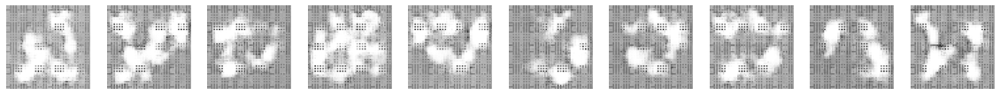

79/79 [==============================] - 5s 57ms/step - d_loss: 0.3049 - d_real_acc: 0.8319 - d_fake_acc: 0.8195 - d_acc: 0.8257 - g_loss: 2.1065 - g_acc: 0.1805
Epoch 26/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.2987 - d_real_acc: 0.8181 - d_fake_acc: 0.8237 - d_acc: 0.8209 - g_loss: 2.1772 - g_acc: 0.1763
Saved to output/generated_img_025.png


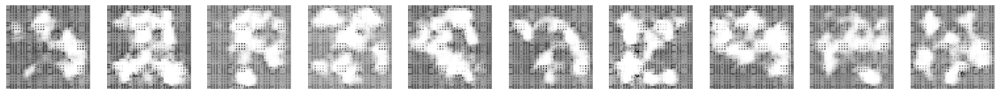

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2951 - d_real_acc: 0.8181 - d_fake_acc: 0.8239 - d_acc: 0.8210 - g_loss: 2.1958 - g_acc: 0.1761
Epoch 27/300
79/79 [==============================] - ETA: 0s - d_loss: 0.2738 - d_real_acc: 0.8351 - d_fake_acc: 0.8309 - d_acc: 0.8330 - g_loss: 2.3242 - g_acc: 0.1691
Saved to output/generated_img_026.png


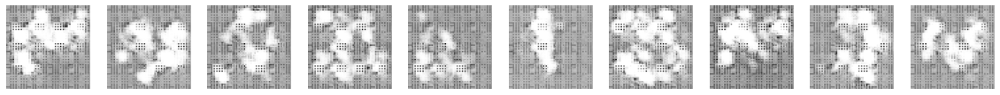

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2738 - d_real_acc: 0.8351 - d_fake_acc: 0.8309 - d_acc: 0.8330 - g_loss: 2.3242 - g_acc: 0.1691
Epoch 28/300
79/79 [==============================] - ETA: 0s - d_loss: 0.2489 - d_real_acc: 0.8471 - d_fake_acc: 0.8455 - d_acc: 0.8463 - g_loss: 2.4495 - g_acc: 0.1545
Saved to output/generated_img_027.png


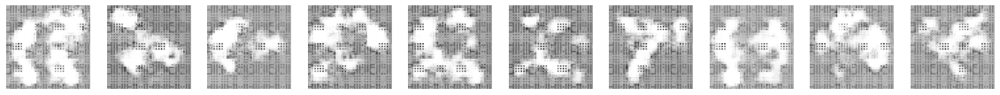

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2489 - d_real_acc: 0.8471 - d_fake_acc: 0.8455 - d_acc: 0.8463 - g_loss: 2.4495 - g_acc: 0.1545
Epoch 29/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.2227 - d_real_acc: 0.8560 - d_fake_acc: 0.8504 - d_acc: 0.8532 - g_loss: 2.5913 - g_acc: 0.1496
Saved to output/generated_img_028.png


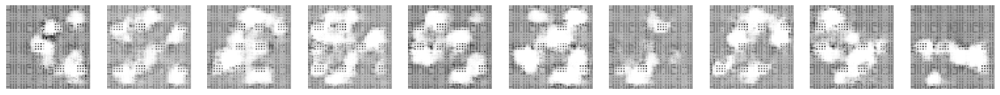

79/79 [==============================] - 4s 49ms/step - d_loss: 0.2283 - d_real_acc: 0.8557 - d_fake_acc: 0.8501 - d_acc: 0.8529 - g_loss: 2.5724 - g_acc: 0.1499
Epoch 30/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.2510 - d_real_acc: 0.8377 - d_fake_acc: 0.8361 - d_acc: 0.8369 - g_loss: 2.5479 - g_acc: 0.1639
Saved to output/generated_img_029.png


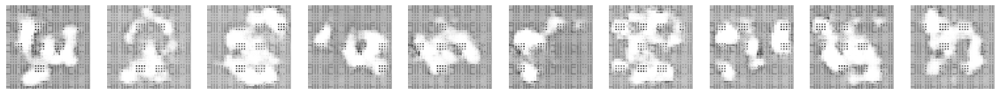

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2547 - d_real_acc: 0.8373 - d_fake_acc: 0.8361 - d_acc: 0.8367 - g_loss: 2.5548 - g_acc: 0.1639
Epoch 31/300
79/79 [==============================] - ETA: 0s - d_loss: 0.2198 - d_real_acc: 0.8521 - d_fake_acc: 0.8499 - d_acc: 0.8510 - g_loss: 2.5572 - g_acc: 0.1501
Saved to output/generated_img_030.png


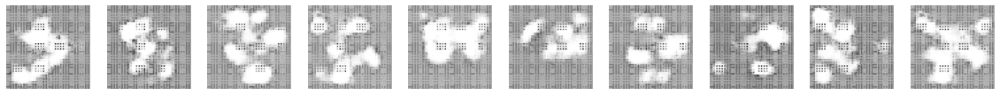

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2198 - d_real_acc: 0.8521 - d_fake_acc: 0.8499 - d_acc: 0.8510 - g_loss: 2.5572 - g_acc: 0.1501
Epoch 32/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.2021 - d_real_acc: 0.8550 - d_fake_acc: 0.8648 - d_acc: 0.8599 - g_loss: 2.7424 - g_acc: 0.1352
Saved to output/generated_img_031.png


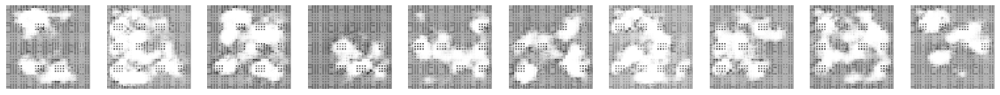

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2027 - d_real_acc: 0.8549 - d_fake_acc: 0.8647 - d_acc: 0.8598 - g_loss: 2.7365 - g_acc: 0.1353
Epoch 33/300
79/79 [==============================] - ETA: 0s - d_loss: 0.1794 - d_real_acc: 0.8743 - d_fake_acc: 0.8701 - d_acc: 0.8722 - g_loss: 2.8287 - g_acc: 0.1299
Saved to output/generated_img_032.png


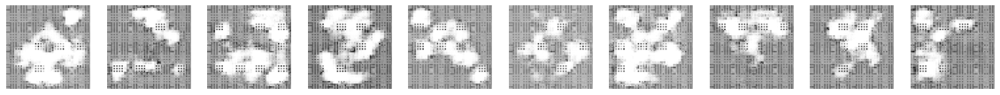

79/79 [==============================] - 4s 50ms/step - d_loss: 0.1794 - d_real_acc: 0.8743 - d_fake_acc: 0.8701 - d_acc: 0.8722 - g_loss: 2.8287 - g_acc: 0.1299
Epoch 34/300
77/79 [============================>.] - ETA: 0s - d_loss: 0.2259 - d_real_acc: 0.8515 - d_fake_acc: 0.8618 - d_acc: 0.8566 - g_loss: 2.9330 - g_acc: 0.1382
Saved to output/generated_img_033.png


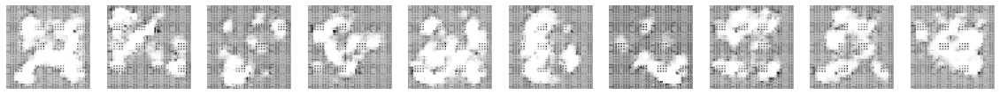

79/79 [==============================] - 4s 50ms/step - d_loss: 0.2256 - d_real_acc: 0.8513 - d_fake_acc: 0.8623 - d_acc: 0.8568 - g_loss: 2.9306 - g_acc: 0.1377
Epoch 35/300
79/79 [==============================] - ETA: 0s - d_loss: 0.1563 - d_real_acc: 0.8797 - d_fake_acc: 0.8769 - d_acc: 0.8783 - g_loss: 2.9737 - g_acc: 0.1231
Saved to output/generated_img_034.png


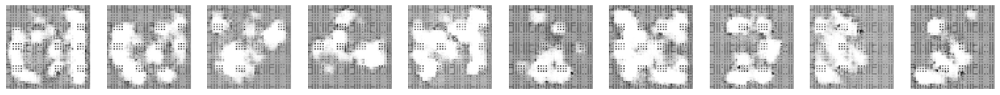

79/79 [==============================] - 4s 50ms/step - d_loss: 0.1563 - d_real_acc: 0.8797 - d_fake_acc: 0.8769 - d_acc: 0.8783 - g_loss: 2.9737 - g_acc: 0.1231
Epoch 36/300
77/79 [============================>.] - ETA: 0s - d_loss: 0.1526 - d_real_acc: 0.8768 - d_fake_acc: 0.8823 - d_acc: 0.8796 - g_loss: 3.1512 - g_acc: 0.1177
Saved to output/generated_img_035.png


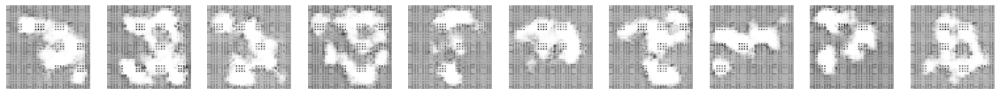

79/79 [==============================] - 4s 50ms/step - d_loss: 0.1544 - d_real_acc: 0.8773 - d_fake_acc: 0.8823 - d_acc: 0.8798 - g_loss: 3.1490 - g_acc: 0.1177
Epoch 37/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.1278 - d_real_acc: 0.8818 - d_fake_acc: 0.8824 - d_acc: 0.8821 - g_loss: 3.1278 - g_acc: 0.1176
Saved to output/generated_img_036.png


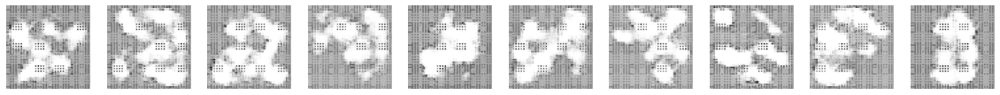

79/79 [==============================] - 5s 56ms/step - d_loss: 0.1268 - d_real_acc: 0.8819 - d_fake_acc: 0.8825 - d_acc: 0.8822 - g_loss: 3.1226 - g_acc: 0.1175
Epoch 38/300
79/79 [==============================] - ETA: 0s - d_loss: 0.1348 - d_real_acc: 0.8753 - d_fake_acc: 0.8835 - d_acc: 0.8794 - g_loss: 3.2118 - g_acc: 0.1165
Saved to output/generated_img_037.png


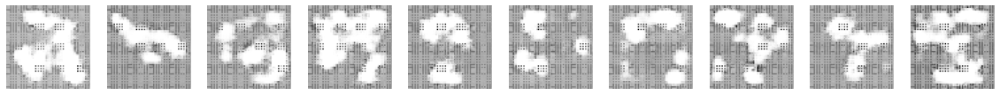

79/79 [==============================] - 4s 50ms/step - d_loss: 0.1348 - d_real_acc: 0.8753 - d_fake_acc: 0.8835 - d_acc: 0.8794 - g_loss: 3.2118 - g_acc: 0.1165
Epoch 39/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.1235 - d_real_acc: 0.8850 - d_fake_acc: 0.8864 - d_acc: 0.8857 - g_loss: 3.2712 - g_acc: 0.1136
Saved to output/generated_img_038.png


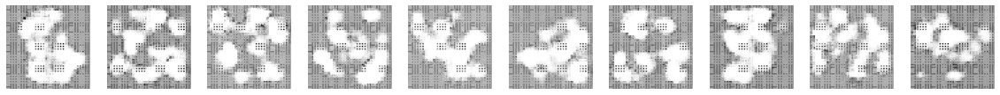

79/79 [==============================] - 4s 50ms/step - d_loss: 0.1232 - d_real_acc: 0.8851 - d_fake_acc: 0.8865 - d_acc: 0.8858 - g_loss: 3.2566 - g_acc: 0.1135
Epoch 40/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.1154 - d_real_acc: 0.8870 - d_fake_acc: 0.8878 - d_acc: 0.8874 - g_loss: 3.3610 - g_acc: 0.1122
Saved to output/generated_img_039.png


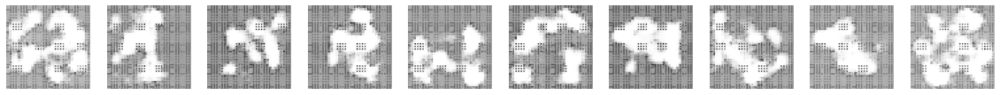

79/79 [==============================] - 4s 51ms/step - d_loss: 0.1157 - d_real_acc: 0.8871 - d_fake_acc: 0.8875 - d_acc: 0.8873 - g_loss: 3.3441 - g_acc: 0.1125
Epoch 41/300
77/79 [============================>.] - ETA: 0s - d_loss: 0.1011 - d_real_acc: 0.8918 - d_fake_acc: 0.8920 - d_acc: 0.8919 - g_loss: 3.5249 - g_acc: 0.1080
Saved to output/generated_img_040.png


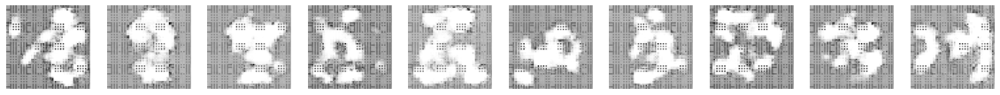

79/79 [==============================] - 4s 49ms/step - d_loss: 0.1001 - d_real_acc: 0.8929 - d_fake_acc: 0.8897 - d_acc: 0.8913 - g_loss: 3.5177 - g_acc: 0.1103
Epoch 42/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.0791 - d_real_acc: 0.9010 - d_fake_acc: 0.9016 - d_acc: 0.9013 - g_loss: 3.6251 - g_acc: 0.0984
Saved to output/generated_img_041.png


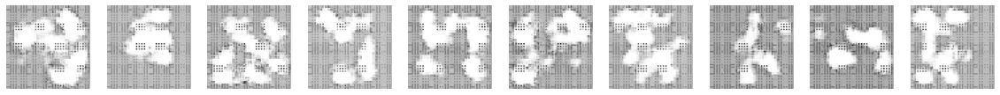

79/79 [==============================] - 4s 50ms/step - d_loss: 0.0761 - d_real_acc: 0.9011 - d_fake_acc: 0.9017 - d_acc: 0.9014 - g_loss: 3.6486 - g_acc: 0.0983
Epoch 43/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.0550 - d_real_acc: 0.9075 - d_fake_acc: 0.9058 - d_acc: 0.9067 - g_loss: 3.8064 - g_acc: 0.0942
Saved to output/generated_img_042.png


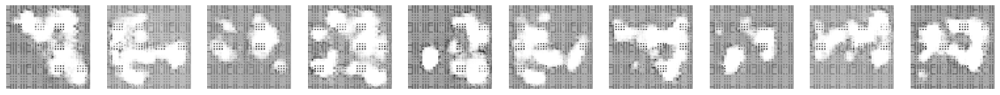

79/79 [==============================] - 4s 51ms/step - d_loss: 0.0562 - d_real_acc: 0.9075 - d_fake_acc: 0.9055 - d_acc: 0.9065 - g_loss: 3.7919 - g_acc: 0.0945
Epoch 44/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.0658 - d_real_acc: 0.9014 - d_fake_acc: 0.9036 - d_acc: 0.9025 - g_loss: 3.7657 - g_acc: 0.0964
Saved to output/generated_img_043.png


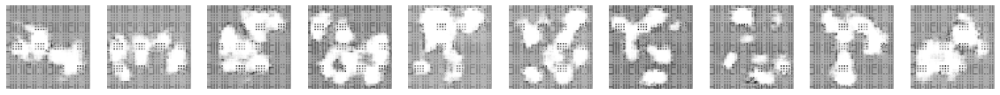

79/79 [==============================] - 4s 50ms/step - d_loss: 0.0678 - d_real_acc: 0.9013 - d_fake_acc: 0.9035 - d_acc: 0.9024 - g_loss: 3.7494 - g_acc: 0.0965
Epoch 45/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.0374 - d_real_acc: 0.9129 - d_fake_acc: 0.9135 - d_acc: 0.9132 - g_loss: 3.8987 - g_acc: 0.0865
Saved to output/generated_img_044.png


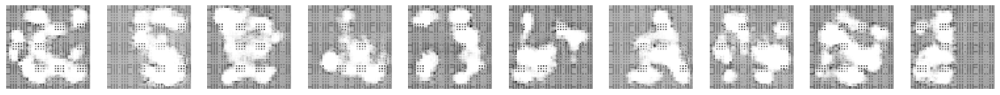

79/79 [==============================] - 4s 49ms/step - d_loss: 0.0375 - d_real_acc: 0.9129 - d_fake_acc: 0.9135 - d_acc: 0.9132 - g_loss: 3.8869 - g_acc: 0.0865
Epoch 46/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.0341 - d_real_acc: 0.9077 - d_fake_acc: 0.9089 - d_acc: 0.9083 - g_loss: 4.0155 - g_acc: 0.0911
Saved to output/generated_img_045.png


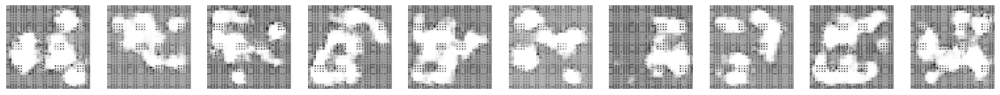

79/79 [==============================] - 4s 51ms/step - d_loss: 0.0324 - d_real_acc: 0.9077 - d_fake_acc: 0.9089 - d_acc: 0.9083 - g_loss: 4.0120 - g_acc: 0.0911
Epoch 47/300
79/79 [==============================] - ETA: 0s - d_loss: 0.0361 - d_real_acc: 0.9107 - d_fake_acc: 0.9051 - d_acc: 0.9079 - g_loss: 4.1031 - g_acc: 0.0949
Saved to output/generated_img_046.png


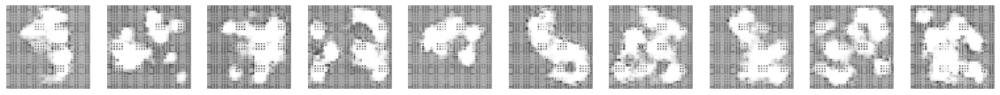

79/79 [==============================] - 4s 51ms/step - d_loss: 0.0361 - d_real_acc: 0.9107 - d_fake_acc: 0.9051 - d_acc: 0.9079 - g_loss: 4.1031 - g_acc: 0.0949
Epoch 48/300
79/79 [==============================] - ETA: 0s - d_loss: 0.0449 - d_real_acc: 0.9095 - d_fake_acc: 0.9031 - d_acc: 0.9063 - g_loss: 4.0889 - g_acc: 0.0969
Saved to output/generated_img_047.png


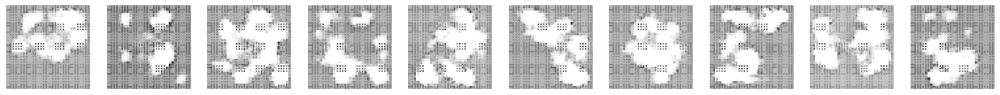

79/79 [==============================] - 4s 51ms/step - d_loss: 0.0449 - d_real_acc: 0.9095 - d_fake_acc: 0.9031 - d_acc: 0.9063 - g_loss: 4.0889 - g_acc: 0.0969
Epoch 49/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.0047 - d_real_acc: 0.9187 - d_fake_acc: 0.9215 - d_acc: 0.9201 - g_loss: 4.2740 - g_acc: 0.0785
Saved to output/generated_img_048.png


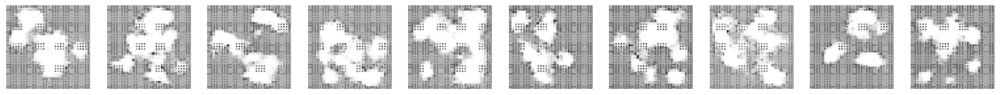

79/79 [==============================] - 5s 56ms/step - d_loss: 0.0083 - d_real_acc: 0.9188 - d_fake_acc: 0.9212 - d_acc: 0.9200 - g_loss: 4.2409 - g_acc: 0.0788
Epoch 50/300
78/79 [============================>.] - ETA: 0s - d_loss: 0.0185 - d_real_acc: 0.9145 - d_fake_acc: 0.9141 - d_acc: 0.9143 - g_loss: 4.3962 - g_acc: 0.0859
Saved to output/generated_img_049.png


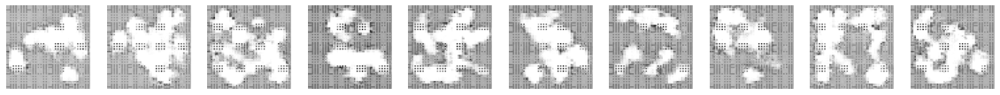

79/79 [==============================] - 4s 50ms/step - d_loss: 0.0146 - d_real_acc: 0.9145 - d_fake_acc: 0.9141 - d_acc: 0.9143 - g_loss: 4.4240 - g_acc: 0.0859
Epoch 51/300
79/79 [==============================] - ETA: 0s - d_loss: -0.0225 - d_real_acc: 0.9284 - d_fake_acc: 0.9272 - d_acc: 0.9278 - g_loss: 4.4706 - g_acc: 0.0728
Saved to output/generated_img_050.png


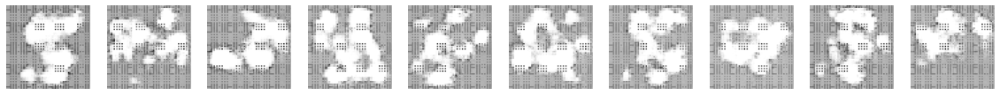

79/79 [==============================] - 4s 50ms/step - d_loss: -0.0225 - d_real_acc: 0.9284 - d_fake_acc: 0.9272 - d_acc: 0.9278 - g_loss: 4.4706 - g_acc: 0.0728
Epoch 52/300
79/79 [==============================] - ETA: 0s - d_loss: -0.0116 - d_real_acc: 0.9204 - d_fake_acc: 0.9246 - d_acc: 0.9225 - g_loss: 4.5201 - g_acc: 0.0754
Saved to output/generated_img_051.png


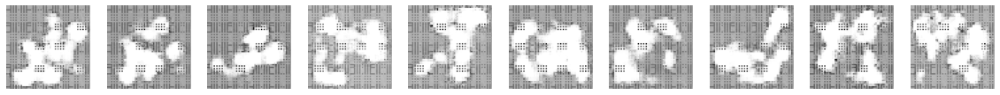

79/79 [==============================] - 4s 50ms/step - d_loss: -0.0116 - d_real_acc: 0.9204 - d_fake_acc: 0.9246 - d_acc: 0.9225 - g_loss: 4.5201 - g_acc: 0.0754
Epoch 53/300
79/79 [==============================] - ETA: 0s - d_loss: -0.0353 - d_real_acc: 0.9242 - d_fake_acc: 0.9226 - d_acc: 0.9234 - g_loss: 4.6467 - g_acc: 0.0774
Saved to output/generated_img_052.png


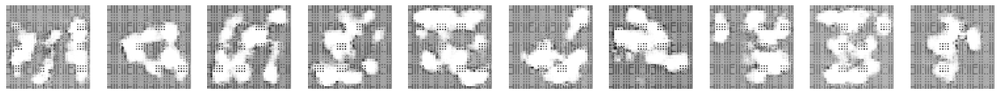

79/79 [==============================] - 4s 51ms/step - d_loss: -0.0353 - d_real_acc: 0.9242 - d_fake_acc: 0.9226 - d_acc: 0.9234 - g_loss: 4.6467 - g_acc: 0.0774
Epoch 54/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.0439 - d_real_acc: 0.9295 - d_fake_acc: 0.9267 - d_acc: 0.9281 - g_loss: 4.7358 - g_acc: 0.0733
Saved to output/generated_img_053.png


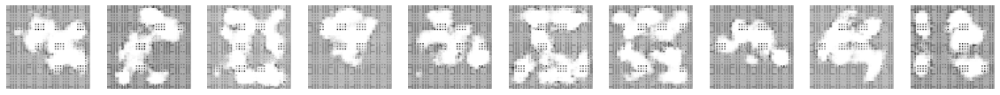

79/79 [==============================] - 4s 50ms/step - d_loss: -0.0467 - d_real_acc: 0.9296 - d_fake_acc: 0.9268 - d_acc: 0.9282 - g_loss: 4.7576 - g_acc: 0.0732
Epoch 55/300
79/79 [==============================] - ETA: 0s - d_loss: -0.0582 - d_real_acc: 0.9296 - d_fake_acc: 0.9302 - d_acc: 0.9299 - g_loss: 4.9795 - g_acc: 0.0698
Saved to output/generated_img_054.png


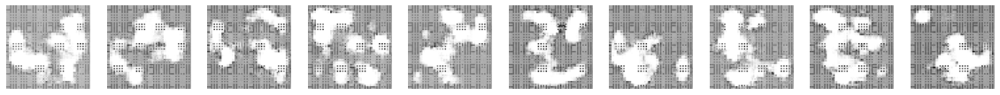

79/79 [==============================] - 4s 51ms/step - d_loss: -0.0582 - d_real_acc: 0.9296 - d_fake_acc: 0.9302 - d_acc: 0.9299 - g_loss: 4.9795 - g_acc: 0.0698
Epoch 56/300
79/79 [==============================] - ETA: 0s - d_loss: -0.0452 - d_real_acc: 0.9290 - d_fake_acc: 0.9274 - d_acc: 0.9282 - g_loss: 4.8999 - g_acc: 0.0726
Saved to output/generated_img_055.png


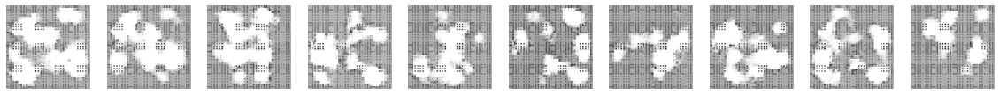

79/79 [==============================] - 4s 51ms/step - d_loss: -0.0452 - d_real_acc: 0.9290 - d_fake_acc: 0.9274 - d_acc: 0.9282 - g_loss: 4.8999 - g_acc: 0.0726
Epoch 57/300
79/79 [==============================] - ETA: 0s - d_loss: -0.0664 - d_real_acc: 0.9360 - d_fake_acc: 0.9336 - d_acc: 0.9348 - g_loss: 5.0359 - g_acc: 0.0664
Saved to output/generated_img_056.png


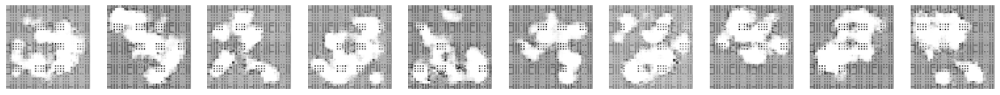

79/79 [==============================] - 4s 50ms/step - d_loss: -0.0664 - d_real_acc: 0.9360 - d_fake_acc: 0.9336 - d_acc: 0.9348 - g_loss: 5.0359 - g_acc: 0.0664
Epoch 58/300
79/79 [==============================] - ETA: 0s - d_loss: -0.0842 - d_real_acc: 0.9376 - d_fake_acc: 0.9338 - d_acc: 0.9357 - g_loss: 5.3345 - g_acc: 0.0662
Saved to output/generated_img_057.png


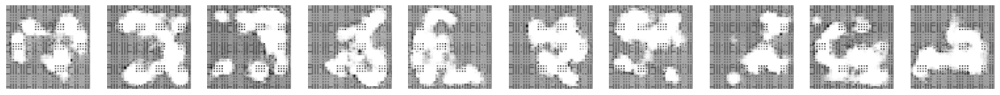

79/79 [==============================] - 4s 51ms/step - d_loss: -0.0842 - d_real_acc: 0.9376 - d_fake_acc: 0.9338 - d_acc: 0.9357 - g_loss: 5.3345 - g_acc: 0.0662
Epoch 59/300
79/79 [==============================] - ETA: 0s - d_loss: -0.1020 - d_real_acc: 0.9414 - d_fake_acc: 0.9404 - d_acc: 0.9409 - g_loss: 5.4992 - g_acc: 0.0596
Saved to output/generated_img_058.png


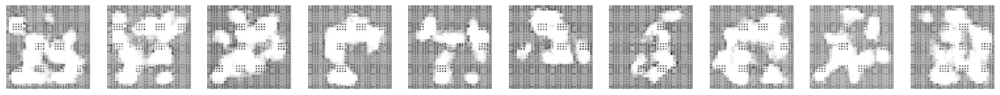

79/79 [==============================] - 4s 50ms/step - d_loss: -0.1020 - d_real_acc: 0.9414 - d_fake_acc: 0.9404 - d_acc: 0.9409 - g_loss: 5.4992 - g_acc: 0.0596
Epoch 60/300
79/79 [==============================] - ETA: 0s - d_loss: -0.1139 - d_real_acc: 0.9406 - d_fake_acc: 0.9418 - d_acc: 0.9412 - g_loss: 5.6034 - g_acc: 0.0582
Saved to output/generated_img_059.png


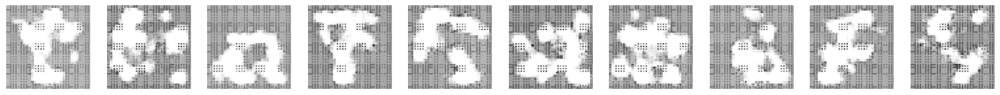

79/79 [==============================] - 4s 52ms/step - d_loss: -0.1139 - d_real_acc: 0.9406 - d_fake_acc: 0.9418 - d_acc: 0.9412 - g_loss: 5.6034 - g_acc: 0.0582
Epoch 61/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.1178 - d_real_acc: 0.9409 - d_fake_acc: 0.9373 - d_acc: 0.9391 - g_loss: 5.6677 - g_acc: 0.0627
Saved to output/generated_img_060.png


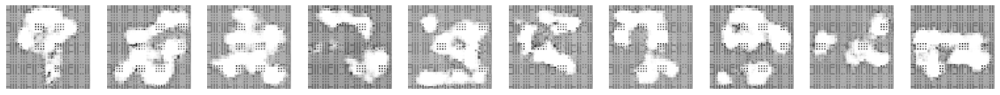

79/79 [==============================] - 5s 57ms/step - d_loss: -0.1196 - d_real_acc: 0.9410 - d_fake_acc: 0.9374 - d_acc: 0.9392 - g_loss: 5.7277 - g_acc: 0.0626
Epoch 62/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.1273 - d_real_acc: 0.9417 - d_fake_acc: 0.9431 - d_acc: 0.9424 - g_loss: 5.7998 - g_acc: 0.0569
Saved to output/generated_img_061.png


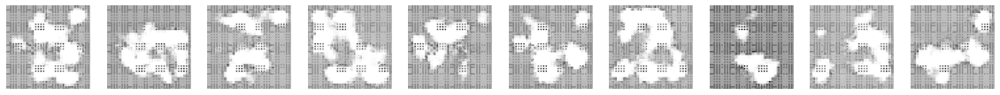

79/79 [==============================] - 4s 52ms/step - d_loss: -0.1290 - d_real_acc: 0.9418 - d_fake_acc: 0.9432 - d_acc: 0.9425 - g_loss: 5.8225 - g_acc: 0.0568
Epoch 63/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.0874 - d_real_acc: 0.9253 - d_fake_acc: 0.9287 - d_acc: 0.9270 - g_loss: 5.8733 - g_acc: 0.0713
Saved to output/generated_img_062.png


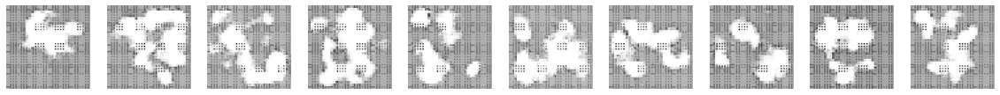

79/79 [==============================] - 4s 51ms/step - d_loss: -0.0822 - d_real_acc: 0.9250 - d_fake_acc: 0.9288 - d_acc: 0.9269 - g_loss: 5.9065 - g_acc: 0.0712
Epoch 64/300
79/79 [==============================] - ETA: 0s - d_loss: -0.1392 - d_real_acc: 0.9474 - d_fake_acc: 0.9420 - d_acc: 0.9447 - g_loss: 5.9059 - g_acc: 0.0580
Saved to output/generated_img_063.png


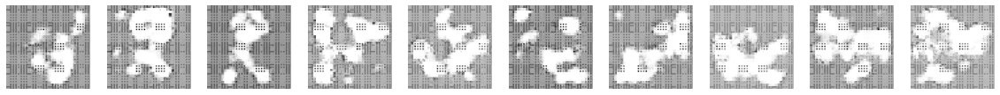

79/79 [==============================] - 4s 50ms/step - d_loss: -0.1392 - d_real_acc: 0.9474 - d_fake_acc: 0.9420 - d_acc: 0.9447 - g_loss: 5.9059 - g_acc: 0.0580
Epoch 65/300
79/79 [==============================] - ETA: 0s - d_loss: -0.1640 - d_real_acc: 0.9454 - d_fake_acc: 0.9496 - d_acc: 0.9475 - g_loss: 6.2121 - g_acc: 0.0504
Saved to output/generated_img_064.png


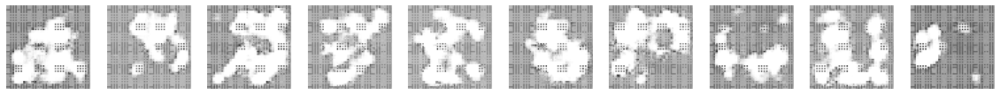

79/79 [==============================] - 4s 50ms/step - d_loss: -0.1640 - d_real_acc: 0.9454 - d_fake_acc: 0.9496 - d_acc: 0.9475 - g_loss: 6.2121 - g_acc: 0.0504
Epoch 66/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.1766 - d_real_acc: 0.9513 - d_fake_acc: 0.9515 - d_acc: 0.9514 - g_loss: 6.3902 - g_acc: 0.0485
Saved to output/generated_img_065.png


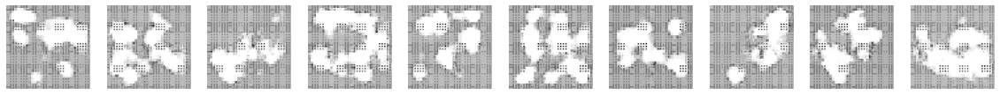

79/79 [==============================] - 4s 50ms/step - d_loss: -0.1788 - d_real_acc: 0.9514 - d_fake_acc: 0.9516 - d_acc: 0.9515 - g_loss: 6.3956 - g_acc: 0.0484
Epoch 67/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.1805 - d_real_acc: 0.9479 - d_fake_acc: 0.9483 - d_acc: 0.9481 - g_loss: 6.5690 - g_acc: 0.0517
Saved to output/generated_img_066.png


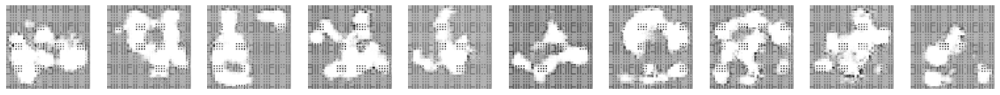

79/79 [==============================] - 4s 51ms/step - d_loss: -0.1825 - d_real_acc: 0.9480 - d_fake_acc: 0.9484 - d_acc: 0.9482 - g_loss: 6.6319 - g_acc: 0.0516
Epoch 68/300
79/79 [==============================] - ETA: 0s - d_loss: -0.2030 - d_real_acc: 0.9542 - d_fake_acc: 0.9538 - d_acc: 0.9540 - g_loss: 6.8148 - g_acc: 0.0462
Saved to output/generated_img_067.png


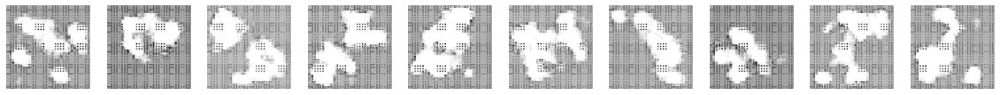

79/79 [==============================] - 4s 51ms/step - d_loss: -0.2030 - d_real_acc: 0.9542 - d_fake_acc: 0.9538 - d_acc: 0.9540 - g_loss: 6.8148 - g_acc: 0.0462
Epoch 69/300
79/79 [==============================] - ETA: 0s - d_loss: -0.1959 - d_real_acc: 0.9550 - d_fake_acc: 0.9520 - d_acc: 0.9535 - g_loss: 6.8227 - g_acc: 0.0480
Saved to output/generated_img_068.png


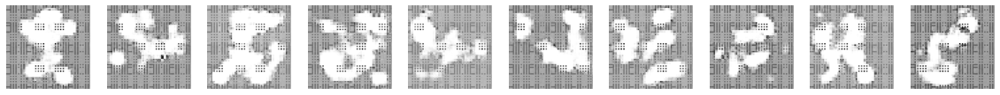

79/79 [==============================] - 4s 51ms/step - d_loss: -0.1959 - d_real_acc: 0.9550 - d_fake_acc: 0.9520 - d_acc: 0.9535 - g_loss: 6.8227 - g_acc: 0.0480
Epoch 70/300
79/79 [==============================] - ETA: 0s - d_loss: -0.2313 - d_real_acc: 0.9584 - d_fake_acc: 0.9596 - d_acc: 0.9590 - g_loss: 7.2392 - g_acc: 0.0404
Saved to output/generated_img_069.png


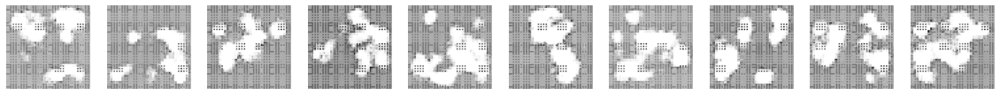

79/79 [==============================] - 4s 50ms/step - d_loss: -0.2313 - d_real_acc: 0.9584 - d_fake_acc: 0.9596 - d_acc: 0.9590 - g_loss: 7.2392 - g_acc: 0.0404
Epoch 71/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.1947 - d_real_acc: 0.9493 - d_fake_acc: 0.9435 - d_acc: 0.9464 - g_loss: 7.0465 - g_acc: 0.0565
Saved to output/generated_img_070.png


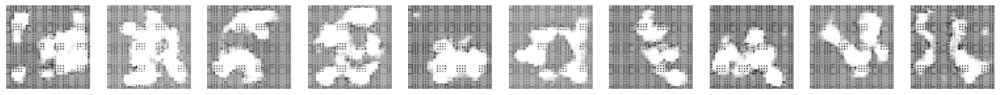

79/79 [==============================] - 4s 50ms/step - d_loss: -0.1967 - d_real_acc: 0.9494 - d_fake_acc: 0.9436 - d_acc: 0.9465 - g_loss: 7.1097 - g_acc: 0.0564
Epoch 72/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.2421 - d_real_acc: 0.9569 - d_fake_acc: 0.9575 - d_acc: 0.9572 - g_loss: 7.3472 - g_acc: 0.0425
Saved to output/generated_img_071.png


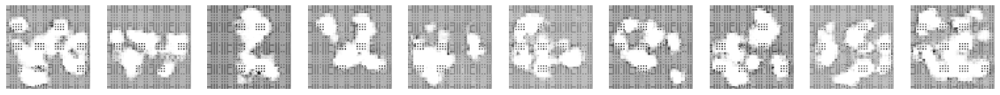

79/79 [==============================] - 4s 50ms/step - d_loss: -0.2384 - d_real_acc: 0.9566 - d_fake_acc: 0.9576 - d_acc: 0.9571 - g_loss: 7.4168 - g_acc: 0.0424
Epoch 73/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.1675 - d_real_acc: 0.9453 - d_fake_acc: 0.9399 - d_acc: 0.9426 - g_loss: 7.0862 - g_acc: 0.0601
Saved to output/generated_img_072.png


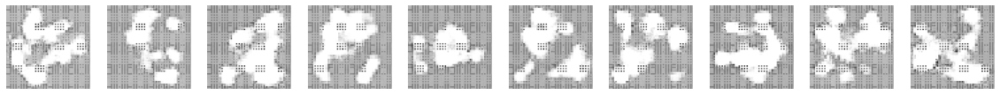

79/79 [==============================] - 5s 57ms/step - d_loss: -0.1703 - d_real_acc: 0.9454 - d_fake_acc: 0.9400 - d_acc: 0.9427 - g_loss: 7.1119 - g_acc: 0.0600
Epoch 74/300
79/79 [==============================] - ETA: 0s - d_loss: -0.2427 - d_real_acc: 0.9568 - d_fake_acc: 0.9596 - d_acc: 0.9582 - g_loss: 7.3884 - g_acc: 0.0404
Saved to output/generated_img_073.png


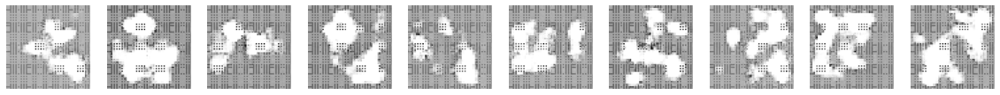

79/79 [==============================] - 4s 51ms/step - d_loss: -0.2427 - d_real_acc: 0.9568 - d_fake_acc: 0.9596 - d_acc: 0.9582 - g_loss: 7.3884 - g_acc: 0.0404
Epoch 75/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.1878 - d_real_acc: 0.9379 - d_fake_acc: 0.9401 - d_acc: 0.9390 - g_loss: 7.4445 - g_acc: 0.0599
Saved to output/generated_img_074.png


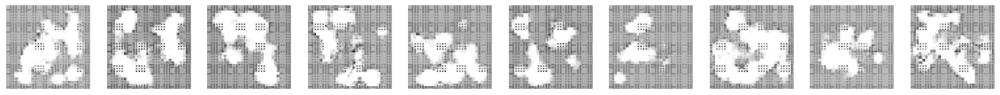

79/79 [==============================] - 4s 50ms/step - d_loss: -0.1911 - d_real_acc: 0.9380 - d_fake_acc: 0.9402 - d_acc: 0.9391 - g_loss: 7.4972 - g_acc: 0.0598
Epoch 76/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.2943 - d_real_acc: 0.9700 - d_fake_acc: 0.9706 - d_acc: 0.9703 - g_loss: 7.9822 - g_acc: 0.0294
Saved to output/generated_img_075.png


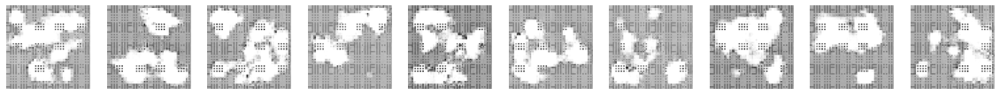

79/79 [==============================] - 4s 51ms/step - d_loss: -0.2947 - d_real_acc: 0.9700 - d_fake_acc: 0.9706 - d_acc: 0.9703 - g_loss: 7.9963 - g_acc: 0.0294
Epoch 77/300
79/79 [==============================] - ETA: 0s - d_loss: -0.2850 - d_real_acc: 0.9614 - d_fake_acc: 0.9618 - d_acc: 0.9616 - g_loss: 8.1698 - g_acc: 0.0382
Saved to output/generated_img_076.png


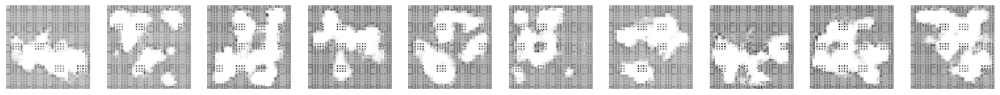

79/79 [==============================] - 4s 50ms/step - d_loss: -0.2850 - d_real_acc: 0.9614 - d_fake_acc: 0.9618 - d_acc: 0.9616 - g_loss: 8.1698 - g_acc: 0.0382
Epoch 78/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.3041 - d_real_acc: 0.9643 - d_fake_acc: 0.9635 - d_acc: 0.9639 - g_loss: 8.4917 - g_acc: 0.0365
Saved to output/generated_img_077.png


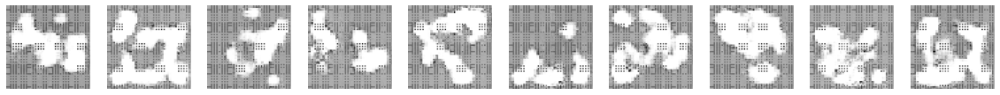

79/79 [==============================] - 4s 51ms/step - d_loss: -0.3027 - d_real_acc: 0.9644 - d_fake_acc: 0.9634 - d_acc: 0.9639 - g_loss: 8.5065 - g_acc: 0.0366
Epoch 79/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.1934 - d_real_acc: 0.9483 - d_fake_acc: 0.9527 - d_acc: 0.9505 - g_loss: 8.0300 - g_acc: 0.0473
Saved to output/generated_img_078.png


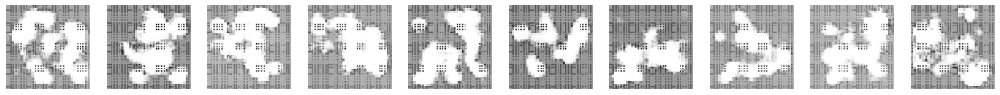

79/79 [==============================] - 4s 50ms/step - d_loss: -0.1966 - d_real_acc: 0.9484 - d_fake_acc: 0.9528 - d_acc: 0.9506 - g_loss: 8.1236 - g_acc: 0.0472
Epoch 80/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.3339 - d_real_acc: 0.9738 - d_fake_acc: 0.9748 - d_acc: 0.9743 - g_loss: 8.5533 - g_acc: 0.0252
Saved to output/generated_img_079.png


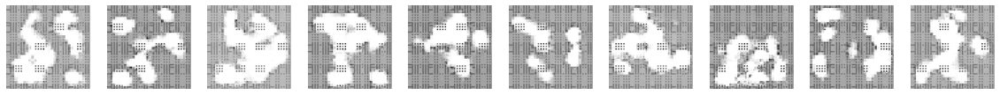

79/79 [==============================] - 4s 51ms/step - d_loss: -0.3347 - d_real_acc: 0.9738 - d_fake_acc: 0.9748 - d_acc: 0.9743 - g_loss: 8.5799 - g_acc: 0.0252
Epoch 81/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.2496 - d_real_acc: 0.9507 - d_fake_acc: 0.9489 - d_acc: 0.9498 - g_loss: 8.2163 - g_acc: 0.0511
Saved to output/generated_img_080.png


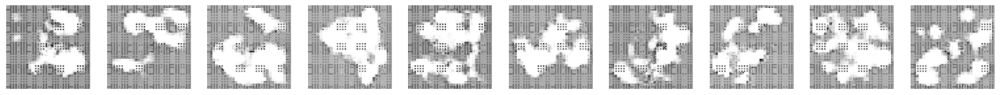

79/79 [==============================] - 4s 51ms/step - d_loss: -0.2340 - d_real_acc: 0.9502 - d_fake_acc: 0.9488 - d_acc: 0.9495 - g_loss: 8.1726 - g_acc: 0.0512
Epoch 82/300
79/79 [==============================] - ETA: 0s - d_loss: -0.2739 - d_real_acc: 0.9602 - d_fake_acc: 0.9560 - d_acc: 0.9581 - g_loss: 8.4733 - g_acc: 0.0440
Saved to output/generated_img_081.png


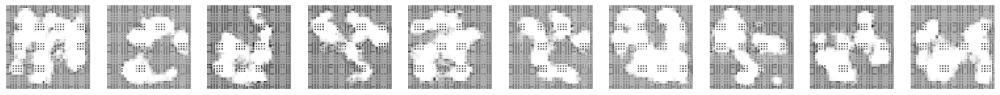

79/79 [==============================] - 4s 50ms/step - d_loss: -0.2739 - d_real_acc: 0.9602 - d_fake_acc: 0.9560 - d_acc: 0.9581 - g_loss: 8.4733 - g_acc: 0.0440
Epoch 83/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.3471 - d_real_acc: 0.9710 - d_fake_acc: 0.9683 - d_acc: 0.9697 - g_loss: 8.8523 - g_acc: 0.0317
Saved to output/generated_img_082.png


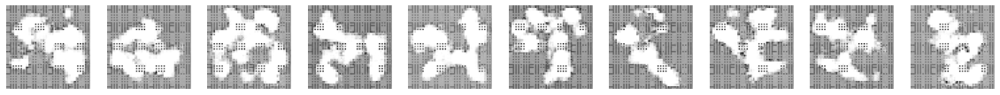

79/79 [==============================] - 4s 50ms/step - d_loss: -0.3430 - d_real_acc: 0.9708 - d_fake_acc: 0.9684 - d_acc: 0.9696 - g_loss: 8.8951 - g_acc: 0.0316
Epoch 84/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.3356 - d_real_acc: 0.9685 - d_fake_acc: 0.9643 - d_acc: 0.9664 - g_loss: 8.9170 - g_acc: 0.0357
Saved to output/generated_img_083.png


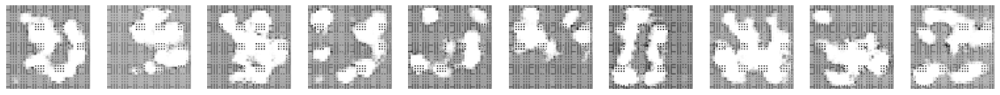

79/79 [==============================] - 4s 50ms/step - d_loss: -0.3361 - d_real_acc: 0.9686 - d_fake_acc: 0.9644 - d_acc: 0.9665 - g_loss: 8.9096 - g_acc: 0.0356
Epoch 85/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.3608 - d_real_acc: 0.9740 - d_fake_acc: 0.9702 - d_acc: 0.9721 - g_loss: 9.1892 - g_acc: 0.0298
Saved to output/generated_img_084.png


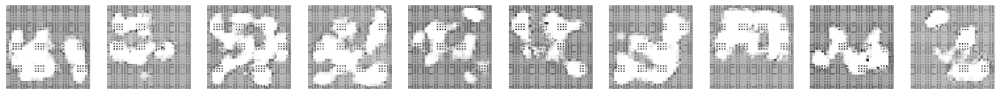

79/79 [==============================] - 5s 57ms/step - d_loss: -0.3623 - d_real_acc: 0.9740 - d_fake_acc: 0.9702 - d_acc: 0.9721 - g_loss: 9.1550 - g_acc: 0.0298
Epoch 86/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.3865 - d_real_acc: 0.9744 - d_fake_acc: 0.9744 - d_acc: 0.9744 - g_loss: 9.4817 - g_acc: 0.0256
Saved to output/generated_img_085.png


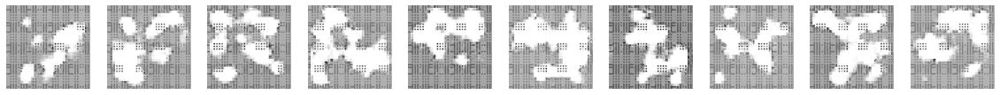

79/79 [==============================] - 4s 51ms/step - d_loss: -0.3896 - d_real_acc: 0.9744 - d_fake_acc: 0.9744 - d_acc: 0.9744 - g_loss: 9.5006 - g_acc: 0.0256
Epoch 87/300
79/79 [==============================] - ETA: 0s - d_loss: -0.3946 - d_real_acc: 0.9718 - d_fake_acc: 0.9732 - d_acc: 0.9725 - g_loss: 9.5476 - g_acc: 0.0268
Saved to output/generated_img_086.png


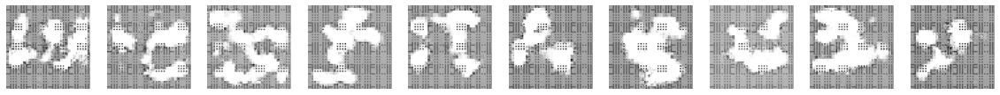

79/79 [==============================] - 4s 49ms/step - d_loss: -0.3946 - d_real_acc: 0.9718 - d_fake_acc: 0.9732 - d_acc: 0.9725 - g_loss: 9.5476 - g_acc: 0.0268
Epoch 88/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.3705 - d_real_acc: 0.9694 - d_fake_acc: 0.9688 - d_acc: 0.9691 - g_loss: 9.5425 - g_acc: 0.0312
Saved to output/generated_img_087.png


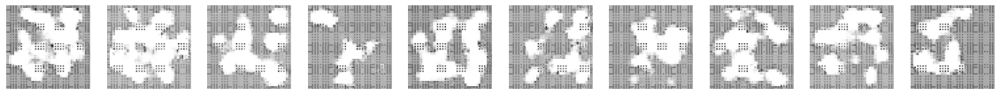

79/79 [==============================] - 4s 50ms/step - d_loss: -0.3749 - d_real_acc: 0.9694 - d_fake_acc: 0.9688 - d_acc: 0.9691 - g_loss: 9.5906 - g_acc: 0.0312
Epoch 89/300
77/79 [============================>.] - ETA: 0s - d_loss: -0.1999 - d_real_acc: 0.9381 - d_fake_acc: 0.9334 - d_acc: 0.9358 - g_loss: 9.1164 - g_acc: 0.0666
Saved to output/generated_img_088.png


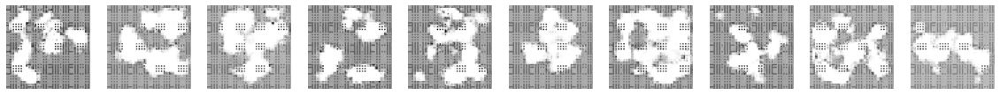

79/79 [==============================] - 4s 50ms/step - d_loss: -0.2080 - d_real_acc: 0.9390 - d_fake_acc: 0.9340 - d_acc: 0.9365 - g_loss: 9.1648 - g_acc: 0.0660
Epoch 90/300
79/79 [==============================] - ETA: 0s - d_loss: -0.4160 - d_real_acc: 0.9800 - d_fake_acc: 0.9802 - d_acc: 0.9801 - g_loss: 9.9781 - g_acc: 0.0198 
Saved to output/generated_img_089.png


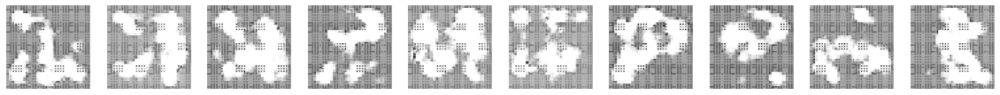

79/79 [==============================] - 4s 50ms/step - d_loss: -0.4160 - d_real_acc: 0.9800 - d_fake_acc: 0.9802 - d_acc: 0.9801 - g_loss: 9.9781 - g_acc: 0.0198
Epoch 91/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.4087 - d_real_acc: 0.9734 - d_fake_acc: 0.9712 - d_acc: 0.9723 - g_loss: 10.0051 - g_acc: 0.0288
Saved to output/generated_img_090.png


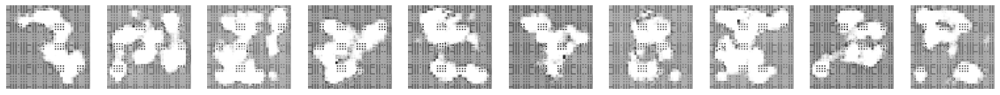

79/79 [==============================] - 4s 51ms/step - d_loss: -0.4086 - d_real_acc: 0.9734 - d_fake_acc: 0.9710 - d_acc: 0.9722 - g_loss: 9.9913 - g_acc: 0.0290
Epoch 92/300
79/79 [==============================] - ETA: 0s - d_loss: -0.4088 - d_real_acc: 0.9728 - d_fake_acc: 0.9676 - d_acc: 0.9702 - g_loss: 10.1558 - g_acc: 0.0324
Saved to output/generated_img_091.png


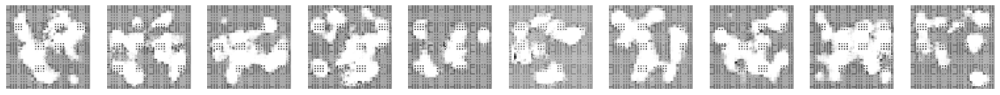

79/79 [==============================] - 4s 51ms/step - d_loss: -0.4088 - d_real_acc: 0.9728 - d_fake_acc: 0.9676 - d_acc: 0.9702 - g_loss: 10.1558 - g_acc: 0.0324
Epoch 93/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.4281 - d_real_acc: 0.9782 - d_fake_acc: 0.9778 - d_acc: 0.9780 - g_loss: 10.2317 - g_acc: 0.0222
Saved to output/generated_img_092.png


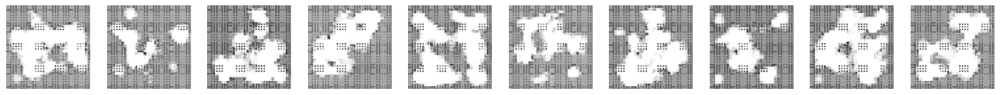

79/79 [==============================] - 4s 51ms/step - d_loss: -0.4264 - d_real_acc: 0.9782 - d_fake_acc: 0.9778 - d_acc: 0.9780 - g_loss: 10.2113 - g_acc: 0.0222
Epoch 94/300
78/79 [============================>.] - ETA: 0s - d_loss: -0.4346 - d_real_acc: 0.9794 - d_fake_acc: 0.9754 - d_acc: 0.9774 - g_loss: 10.4767 - g_acc: 0.0246
Saved to output/generated_img_093.png


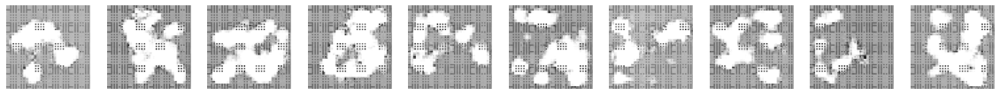

79/79 [==============================] - 4s 52ms/step - d_loss: -0.3720 - d_real_acc: 0.9794 - d_fake_acc: 0.9744 - d_acc: 0.9769 - g_loss: 10.3441 - g_acc: 0.0256
Epoch 95/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7202 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_094.png


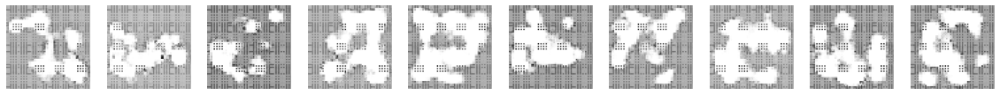

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7219 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 96/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7177 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_095.png


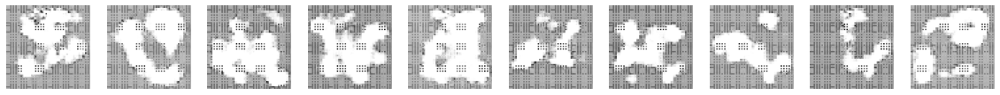

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7177 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 97/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7127 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_096.png


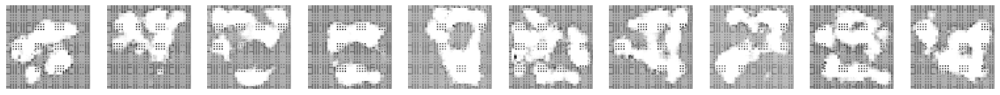

79/79 [==============================] - 5s 56ms/step - d_loss: 7.7140 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 98/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7197 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_097.png


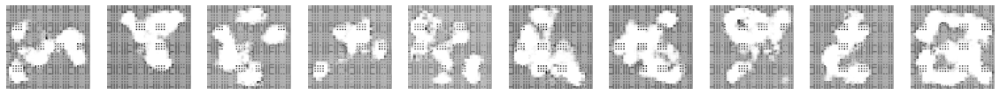

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7183 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 99/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7189 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_098.png


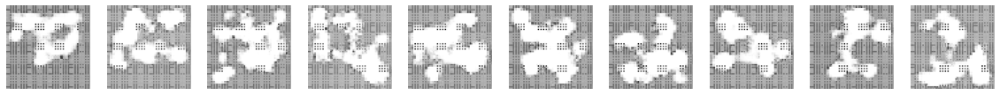

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7189 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 100/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7014 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_099.png


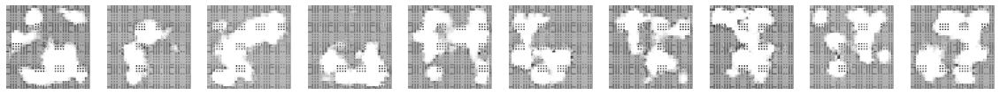

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7009 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 101/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7140 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_100.png


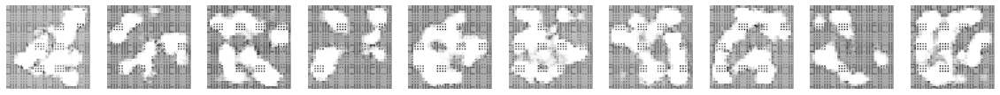

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7145 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 102/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7101 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_101.png


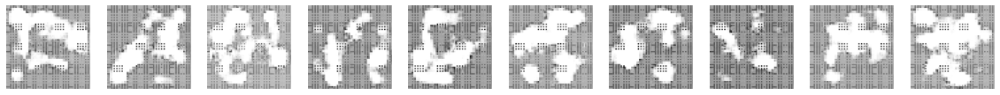

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7098 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 103/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7187 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_102.png


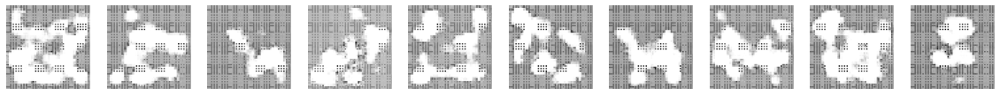

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7190 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 104/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7120 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_103.png


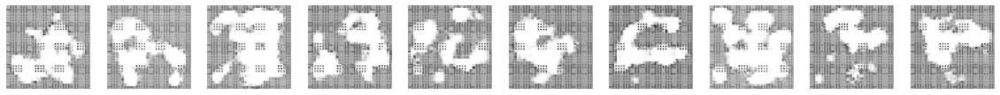

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7137 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 105/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7112 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_104.png


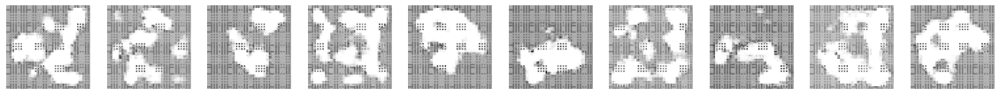

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7112 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 106/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7187 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_105.png


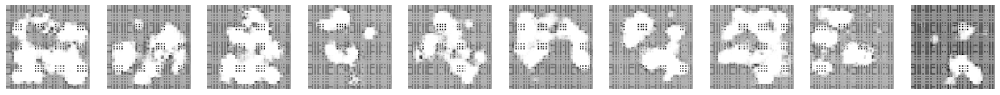

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7187 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 107/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7109 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_106.png


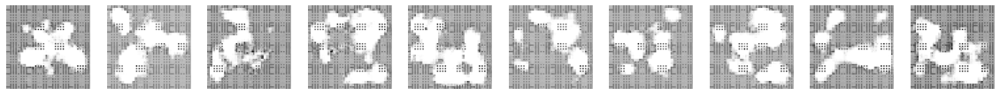

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7078 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 108/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7089 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_107.png


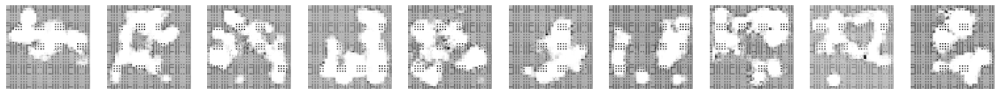

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7089 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 109/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7094 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_108.png


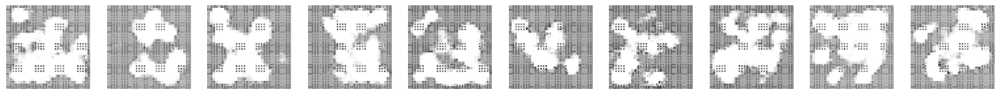

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7090 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 110/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7138 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_109.png


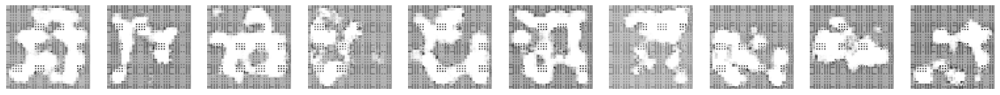

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7113 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 111/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7138 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_110.png


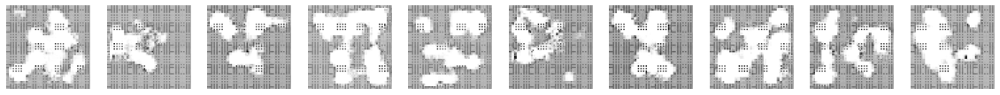

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7138 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 112/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7093 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_111.png


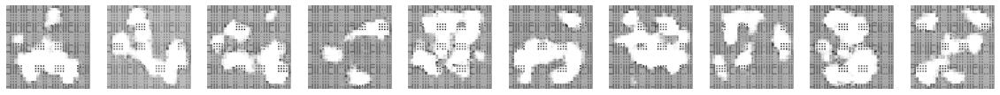

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7074 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 113/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7097 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_112.png


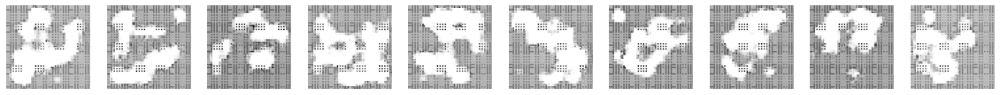

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7092 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 114/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7164 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_113.png


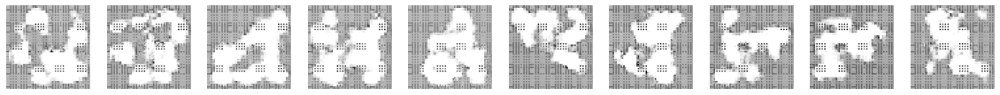

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7164 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 115/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7105 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_114.png


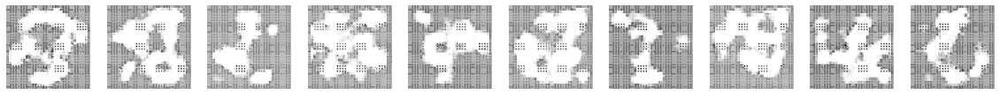

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7105 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 116/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7171 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_115.png


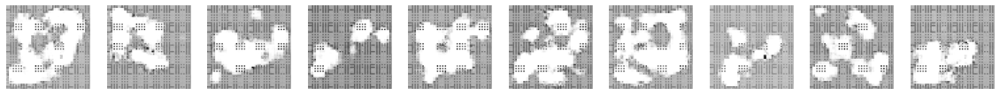

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7168 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 117/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7168 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_116.png


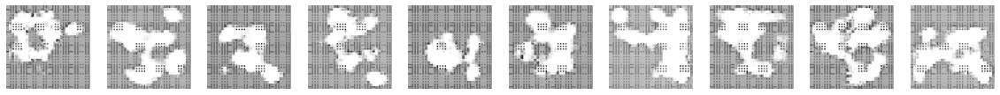

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7160 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 118/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7239 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_117.png


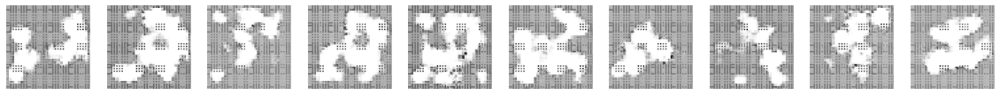

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7253 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 119/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7182 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_118.png


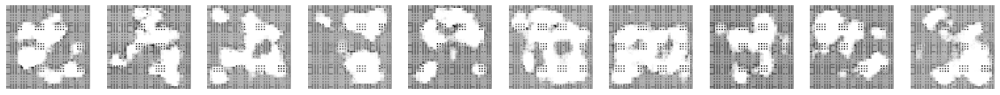

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7182 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 120/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7057 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_119.png


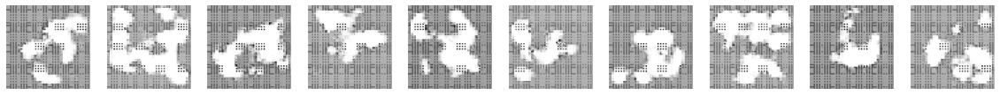

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7084 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 121/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7111 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_120.png


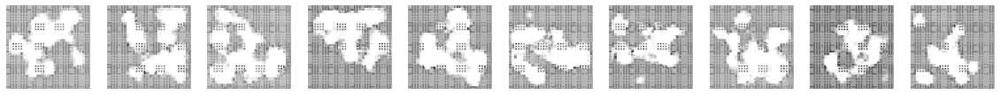

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7110 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 122/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7159 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_121.png


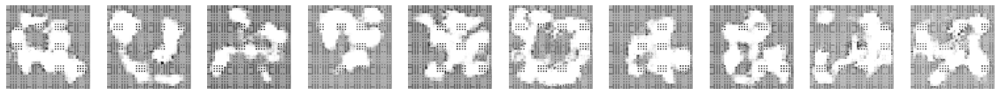

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7134 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 123/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7168 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_122.png


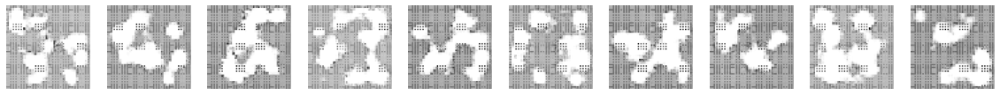

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7168 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 124/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7038 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_123.png


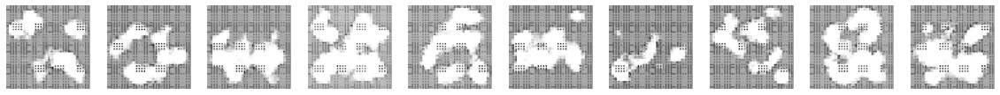

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7038 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 125/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7132 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_124.png


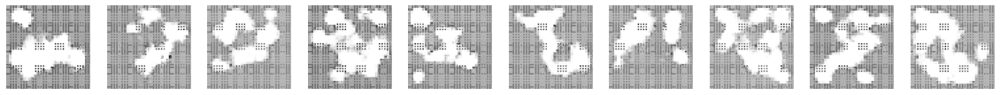

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7136 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 126/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7063 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_125.png


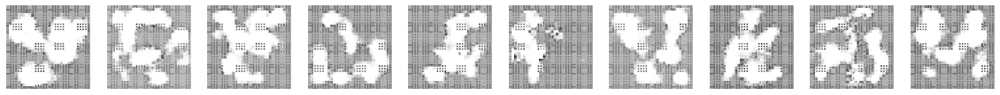

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7063 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 127/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7100 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_126.png


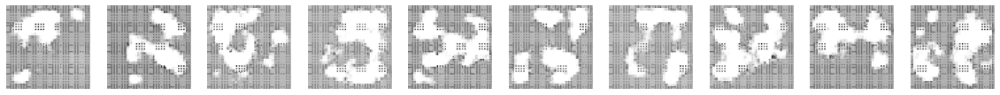

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7109 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 128/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7179 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_127.png


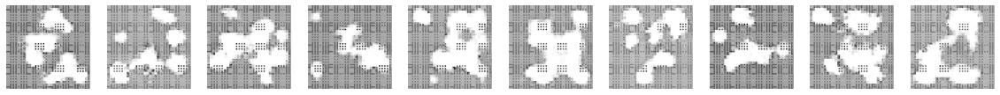

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7179 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 129/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7156 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_128.png


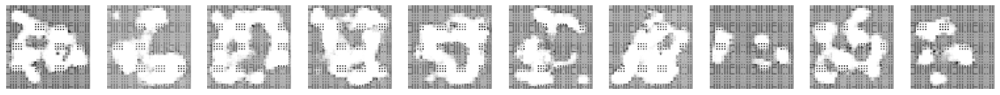

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7156 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 130/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7193 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_129.png


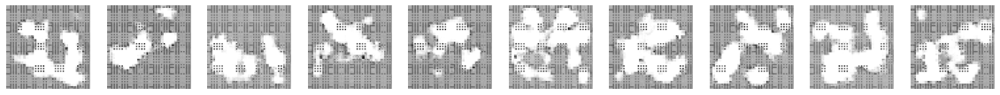

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7180 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 131/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7085 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_130.png


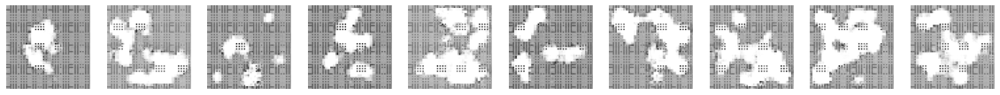

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7085 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 132/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7130 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_131.png


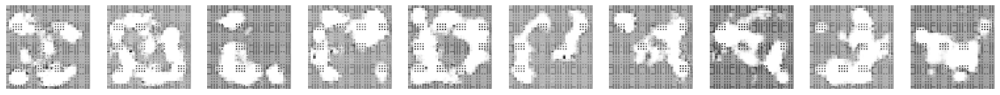

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7131 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 133/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_132.png


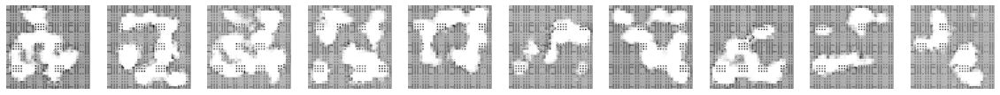

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 134/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_133.png


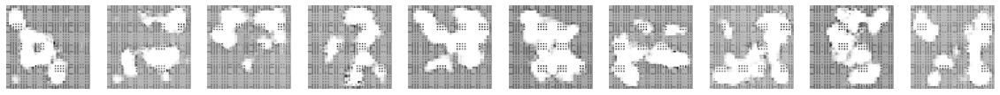

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 135/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7197 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_134.png


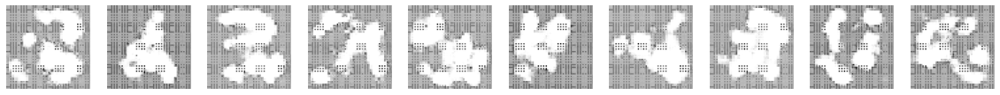

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7197 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 136/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7228 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_135.png


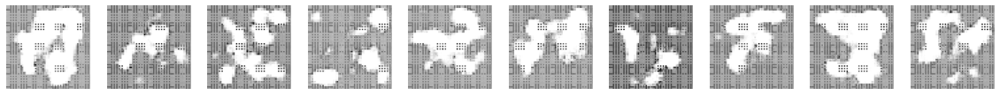

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7213 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 137/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7139 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_136.png


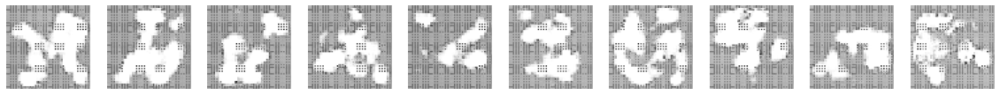

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7139 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 138/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7009 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_137.png


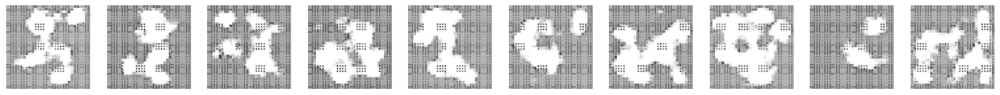

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7009 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 139/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7098 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_138.png


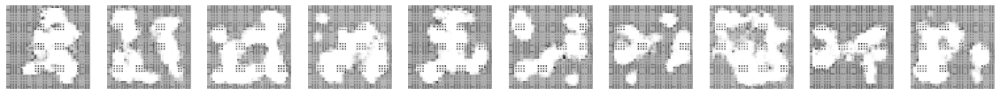

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7108 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 140/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7089 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_139.png


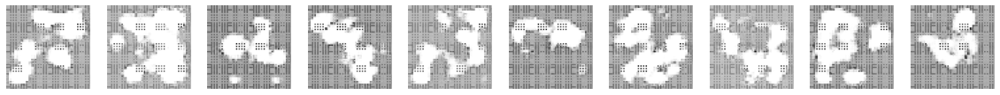

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7089 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 141/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7112 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_140.png


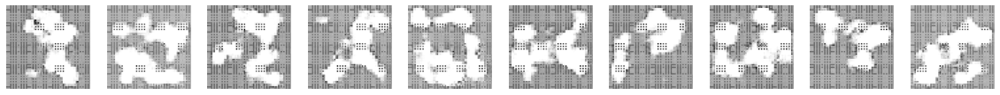

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7104 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 142/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7046 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_141.png


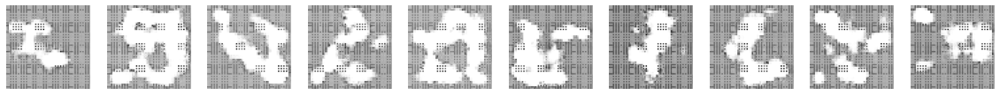

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7046 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 143/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7037 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_142.png


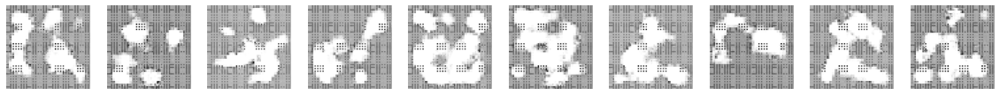

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7037 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 144/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7141 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_143.png


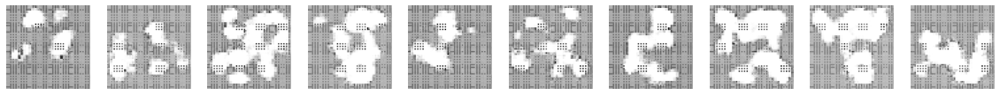

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7180 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 145/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7161 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_144.png


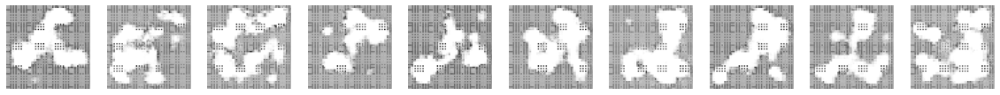

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7161 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 146/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7139 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_145.png


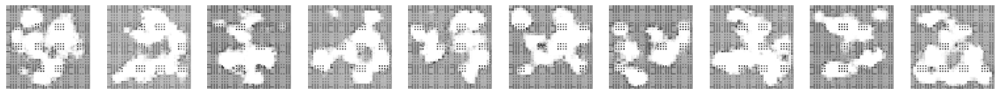

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7144 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 147/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7092 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_146.png


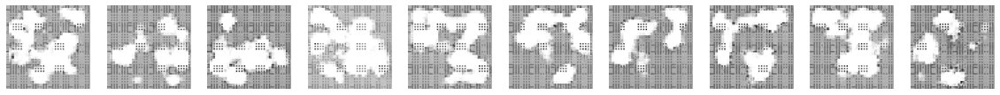

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7092 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 148/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7102 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_147.png


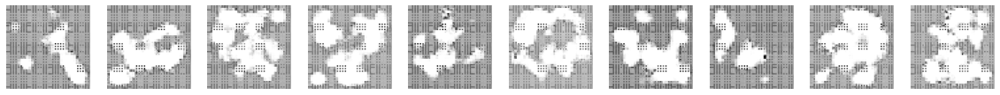

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7121 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 149/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7071 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_148.png


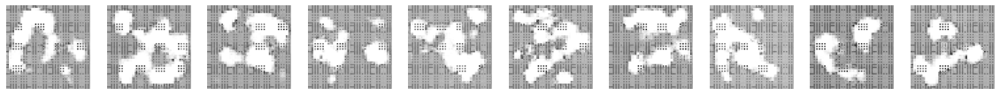

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7079 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 150/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7074 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_149.png


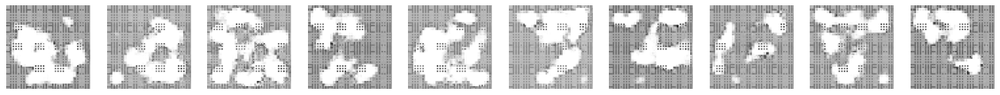

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7074 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 151/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7183 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_150.png


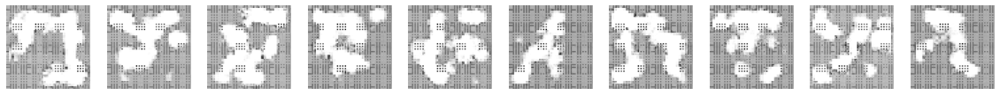

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7183 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 152/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7168 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_151.png


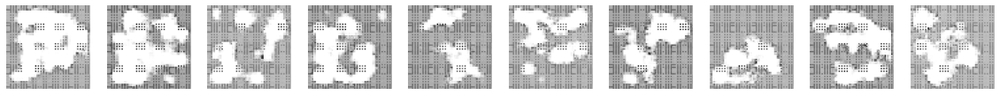

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7142 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 153/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7202 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_152.png


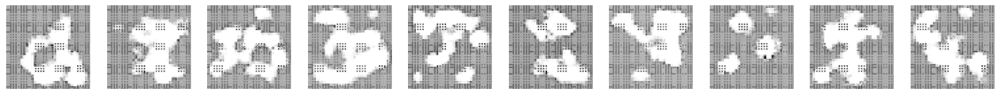

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7202 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 154/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7121 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_153.png


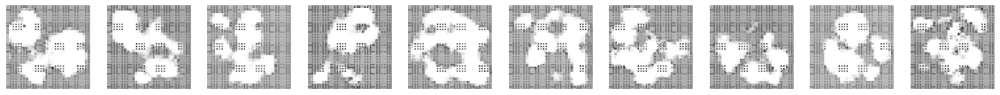

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7122 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 155/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7047 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_154.png


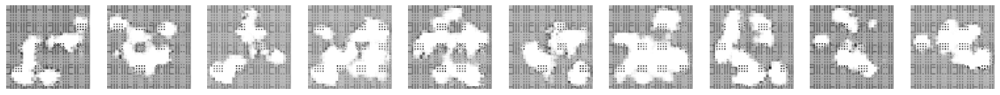

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7047 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 156/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7099 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_155.png


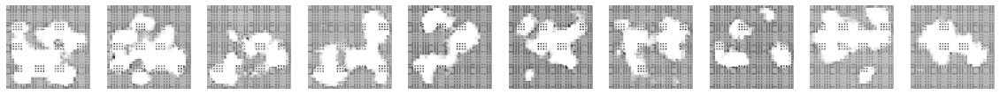

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7099 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 157/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7082 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_156.png


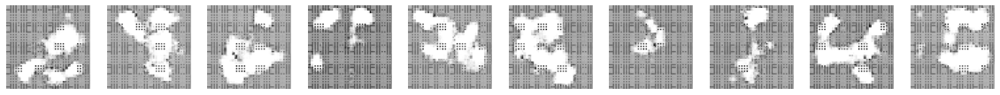

79/79 [==============================] - 5s 58ms/step - d_loss: 7.7082 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 158/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7078 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_157.png


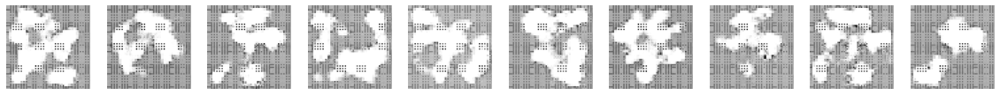

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7078 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 159/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7174 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_158.png


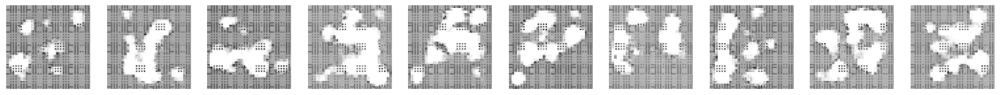

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7198 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 160/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7220 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_159.png


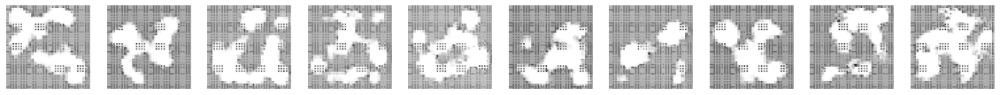

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7216 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 161/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7068 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_160.png


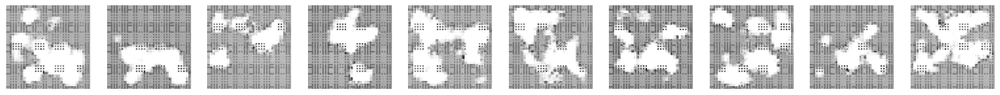

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7069 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 162/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7202 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_161.png


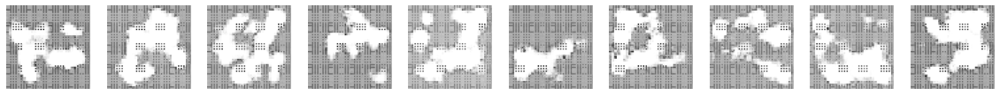

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7212 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 163/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7122 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_162.png


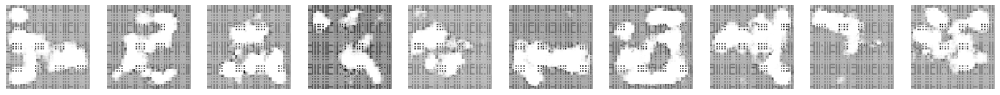

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7122 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 164/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7118 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_163.png


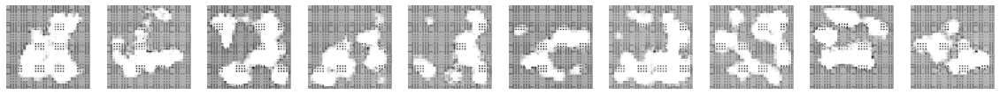

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7141 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 165/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7145 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_164.png


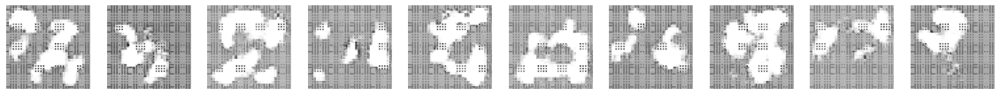

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7112 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 166/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7151 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_165.png


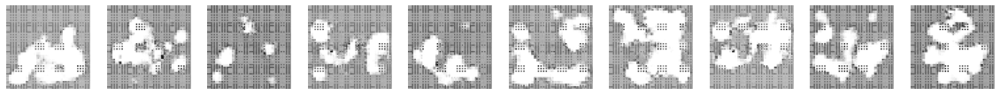

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7151 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 167/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7089 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_166.png


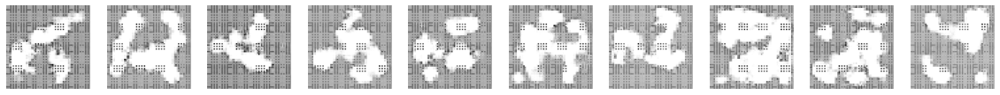

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7089 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 168/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7172 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_167.png


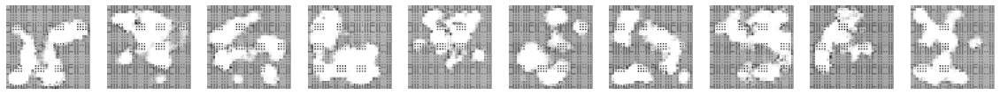

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7172 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 169/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7177 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_168.png


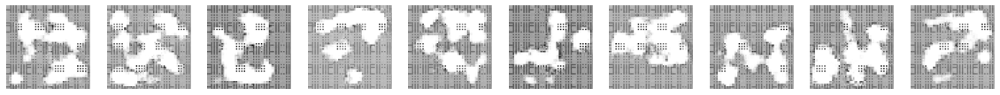

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7176 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 170/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7041 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_169.png


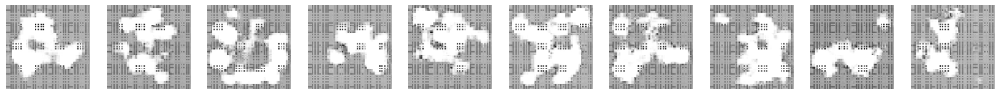

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7056 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 171/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7076 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_170.png


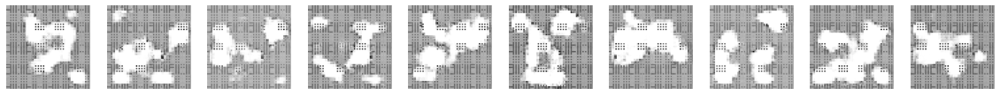

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7076 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 172/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7099 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_171.png


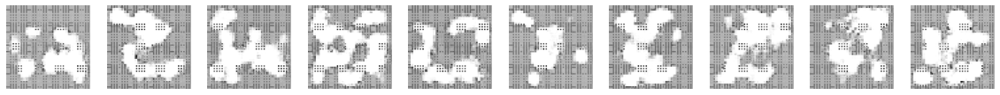

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7099 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 173/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7115 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_172.png


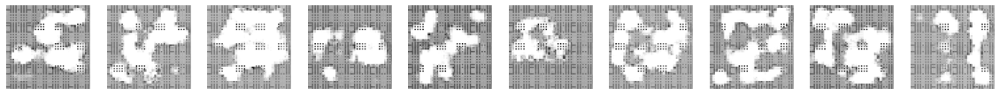

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7124 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 174/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7087 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_173.png


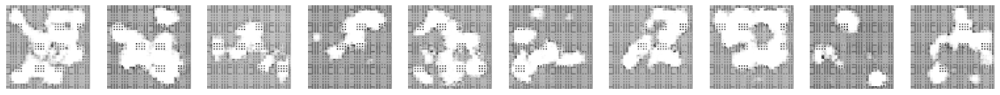

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7071 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 175/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7124 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_174.png


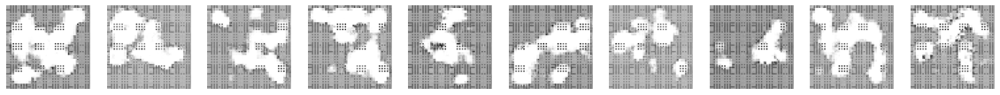

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7128 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 176/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7124 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_175.png


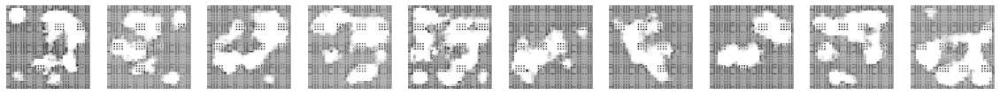

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7140 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 177/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7127 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_176.png


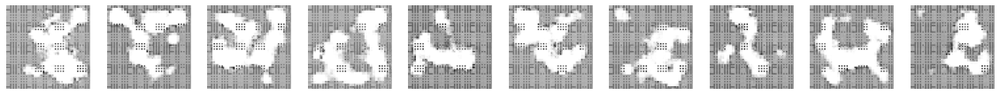

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7127 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 178/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7123 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_177.png


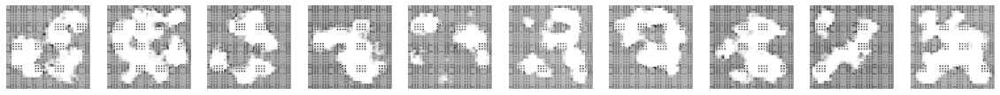

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7116 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 179/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7073 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_178.png


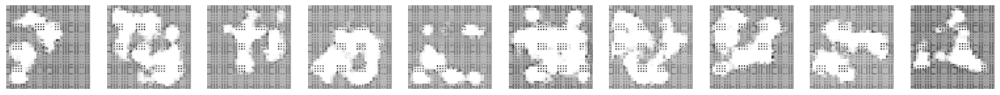

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7073 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 180/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7110 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_179.png


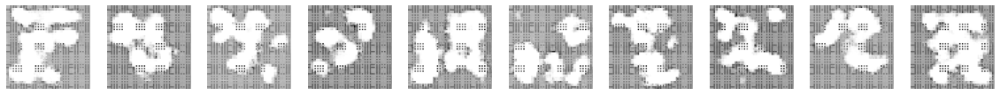

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7116 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 181/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7185 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_180.png


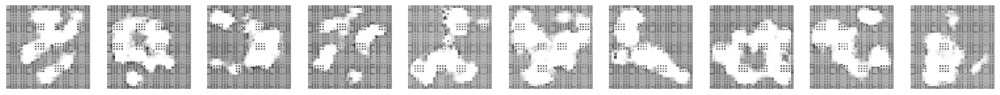

79/79 [==============================] - 5s 56ms/step - d_loss: 7.7201 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 182/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7124 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_181.png


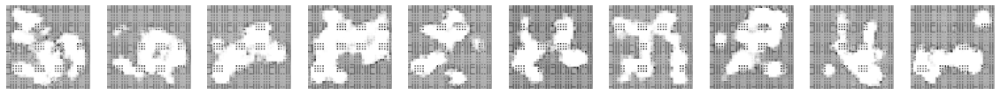

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7124 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 183/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7120 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_182.png


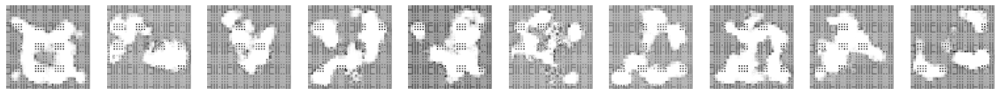

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7104 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 184/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7074 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_183.png


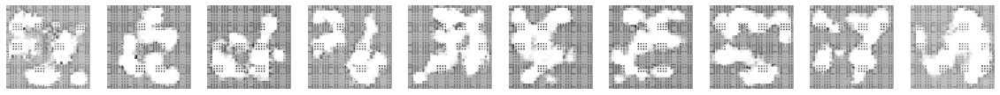

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7084 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 185/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7192 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_184.png


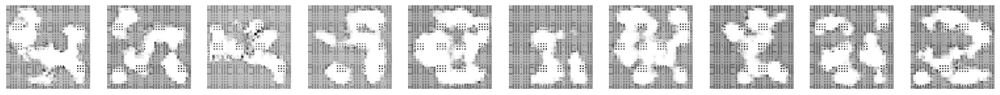

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7192 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 186/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7125 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_185.png


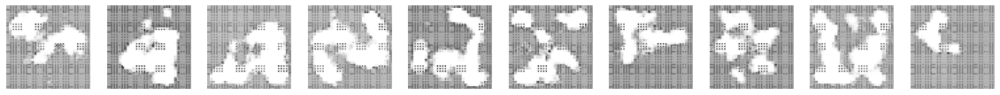

79/79 [==============================] - 4s 53ms/step - d_loss: 7.7125 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 187/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7138 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_186.png


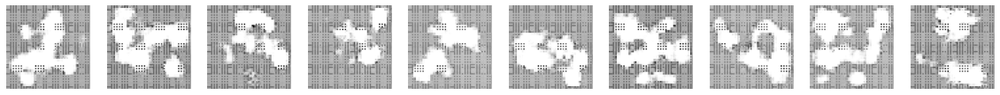

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7138 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 188/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7109 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_187.png


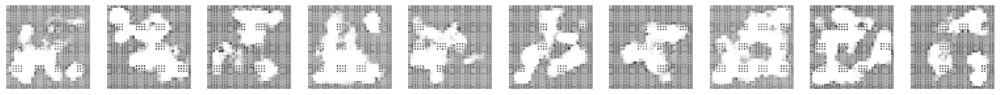

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7109 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 189/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7091 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_188.png


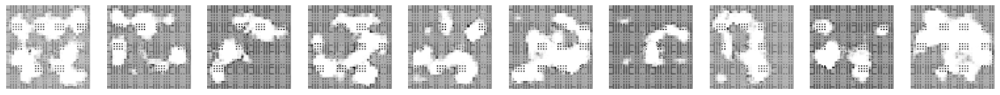

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7091 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 190/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7129 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_189.png


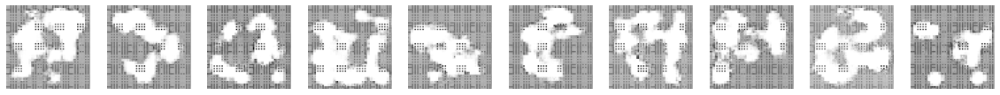

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7113 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 191/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7083 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_190.png


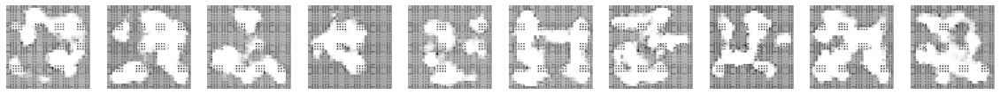

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7083 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 192/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7146 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_191.png


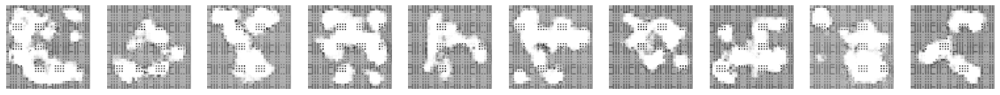

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7125 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 193/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7098 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_192.png


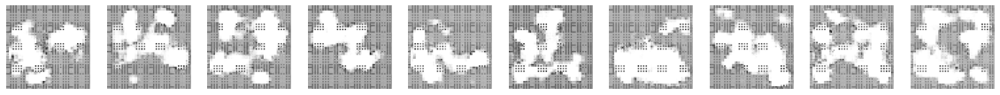

79/79 [==============================] - 5s 56ms/step - d_loss: 7.7098 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 194/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7137 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_193.png


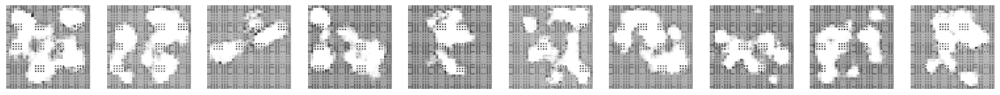

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7170 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 195/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7145 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_194.png


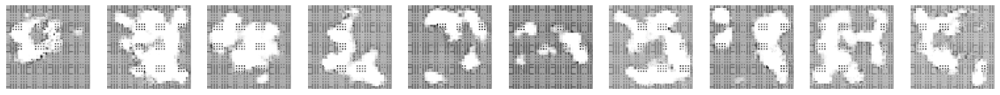

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7145 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 196/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7187 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_195.png


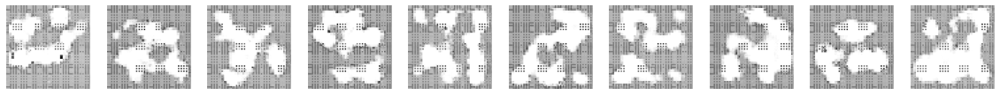

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7187 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 197/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7083 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_196.png


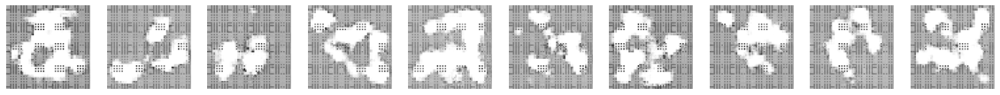

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7078 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 198/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7187 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_197.png


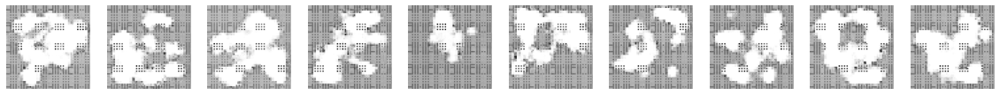

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7187 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 199/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7100 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_198.png


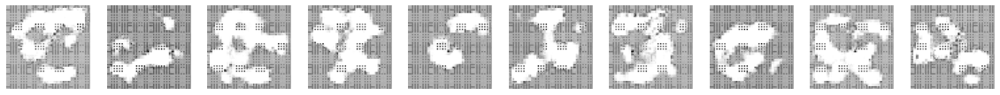

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7120 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 200/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7152 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_199.png


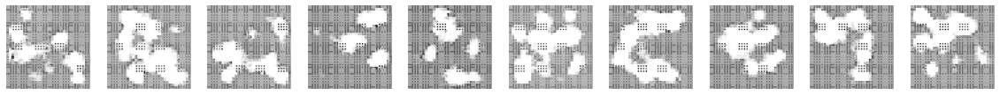

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7165 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 201/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7180 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_200.png


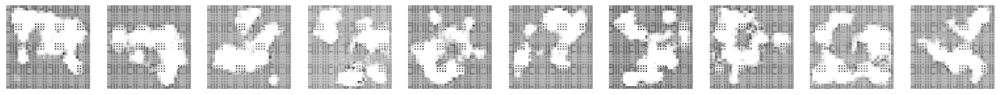

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7180 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 202/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7105 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_201.png


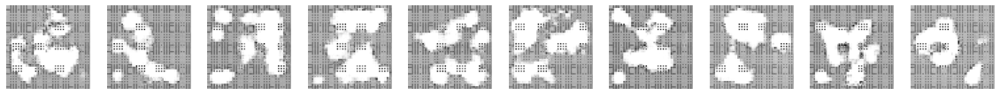

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7105 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 203/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7104 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_202.png


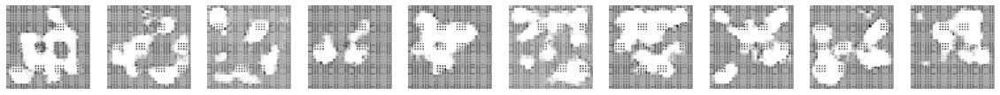

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7104 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 204/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7168 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_203.png


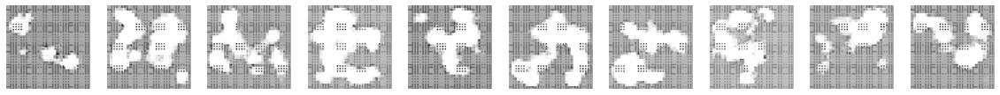

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7168 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 205/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7139 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_204.png


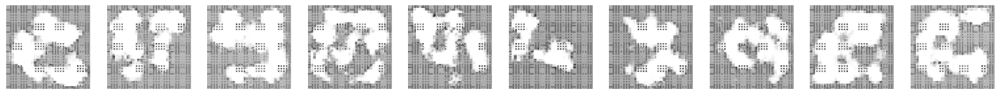

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7139 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 206/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7122 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_205.png


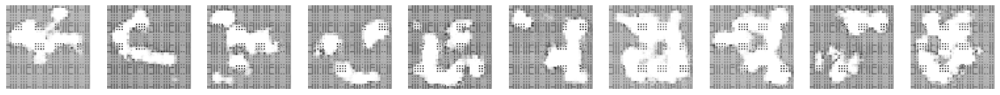

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7129 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 207/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7063 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_206.png


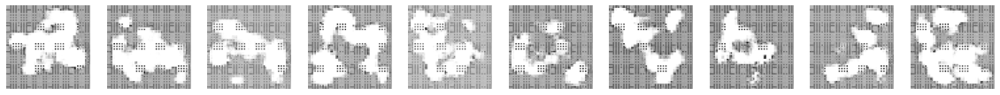

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7075 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 208/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7088 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_207.png


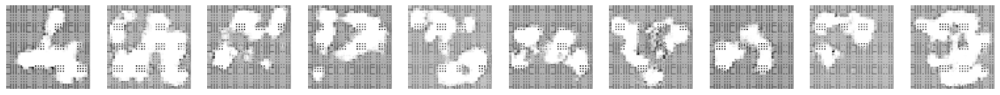

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7094 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 209/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7144 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_208.png


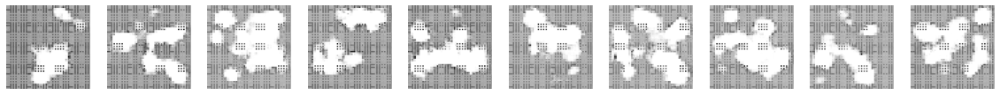

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7118 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 210/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7150 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_209.png


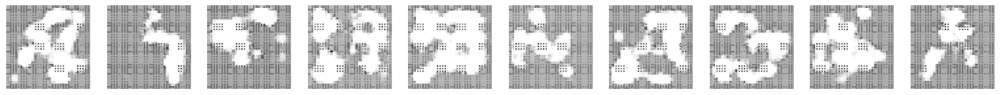

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7161 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 211/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7142 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_210.png


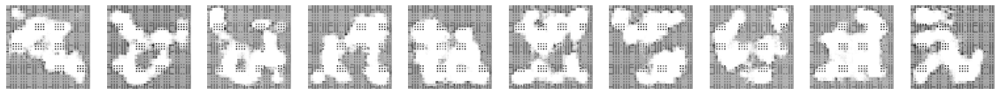

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7142 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 212/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_211.png


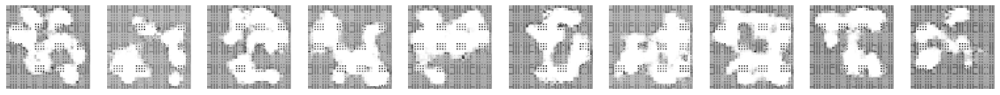

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 213/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7176 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_212.png


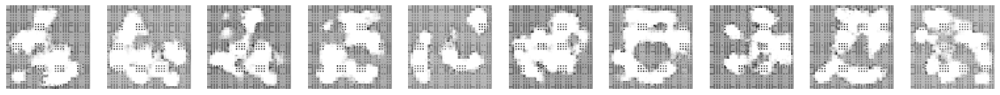

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7195 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 214/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7234 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_213.png


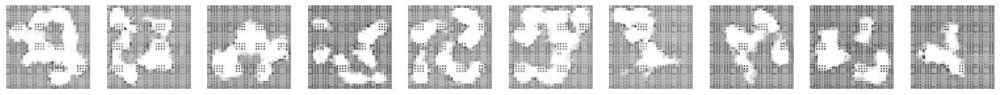

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7234 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 215/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7113 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_214.png


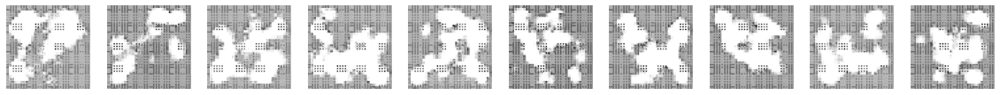

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7113 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 216/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7119 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_215.png


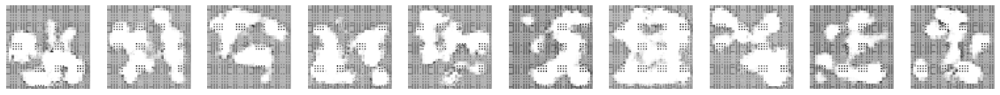

79/79 [==============================] - 4s 53ms/step - d_loss: 7.7119 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 217/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7091 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_216.png


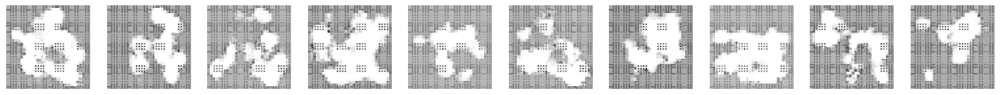

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7091 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 218/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7116 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_217.png


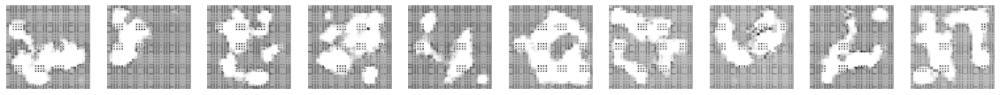

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7116 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 219/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7112 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_218.png


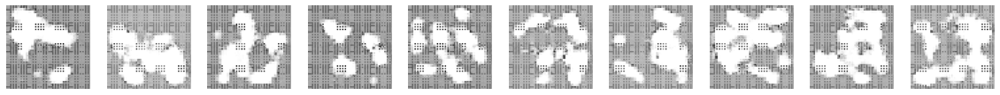

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7118 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 220/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7147 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_219.png


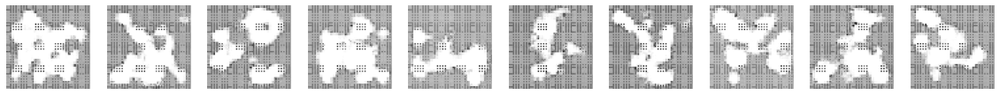

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7162 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 221/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7145 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_220.png


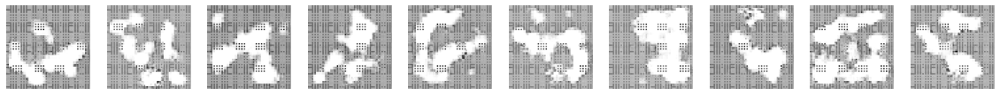

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7164 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 222/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7084 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_221.png


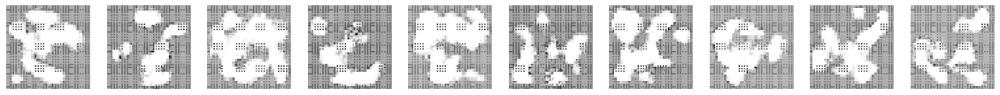

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7084 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 223/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7179 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_222.png


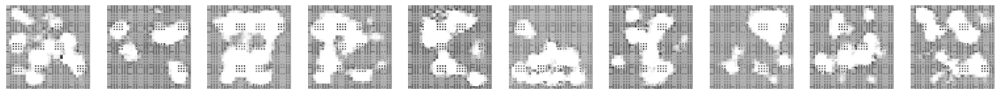

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7195 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 224/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7094 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_223.png


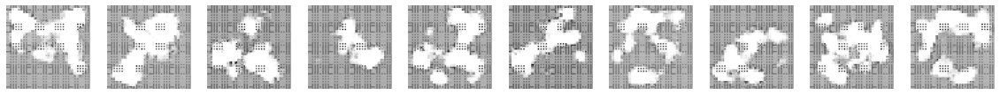

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7094 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 225/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7140 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_224.png


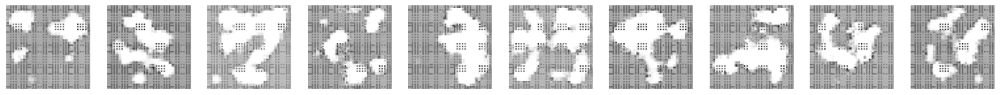

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7111 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 226/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7175 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_225.png


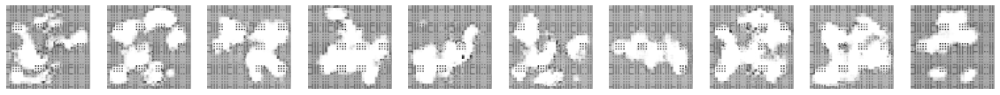

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7192 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 227/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7088 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_226.png


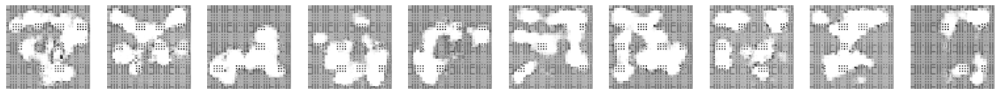

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7088 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 228/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7057 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_227.png


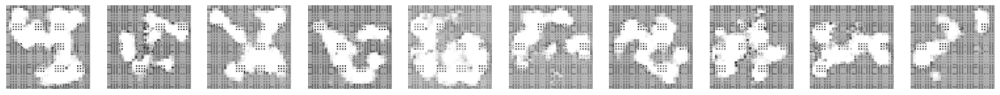

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7062 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 229/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7042 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_228.png


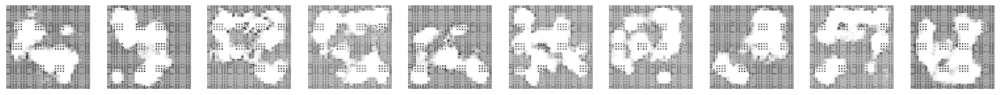

79/79 [==============================] - 5s 56ms/step - d_loss: 7.7040 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 230/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7025 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_229.png


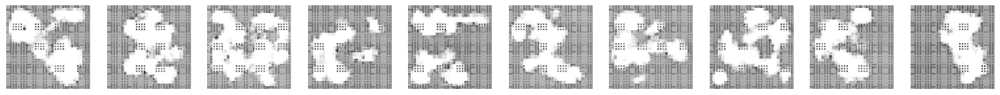

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7017 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 231/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7038 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_230.png


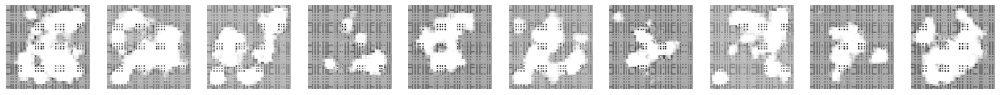

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7038 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 232/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7102 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_231.png


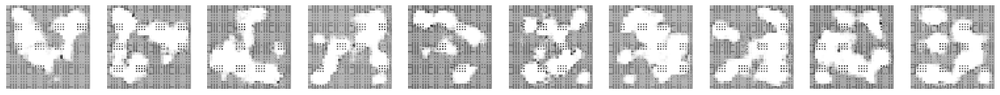

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7102 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 233/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7203 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_232.png


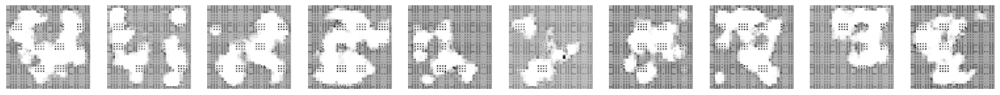

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7237 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 234/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7093 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_233.png


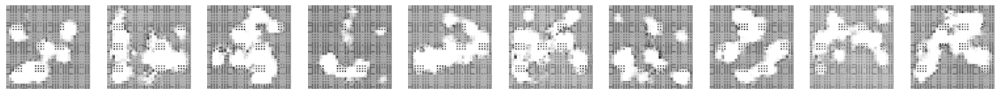

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7099 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 235/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7161 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_234.png


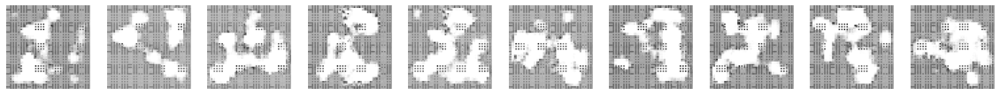

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7155 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 236/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7036 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_235.png


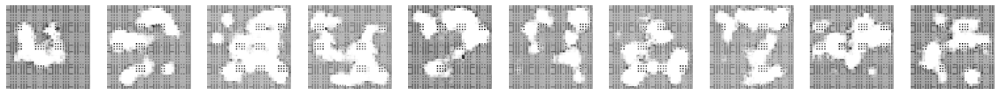

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7036 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 237/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7143 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_236.png


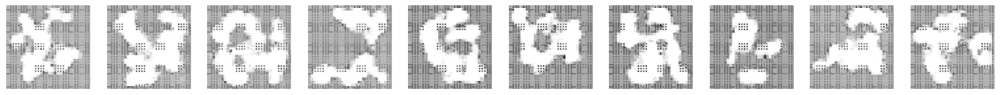

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7143 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 238/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7173 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_237.png


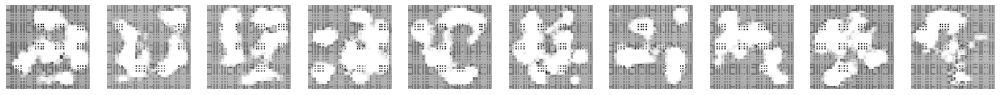

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7156 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 239/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7188 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_238.png


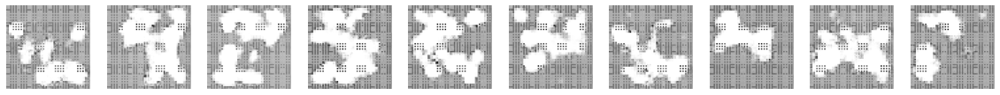

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7203 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 240/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7081 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_239.png


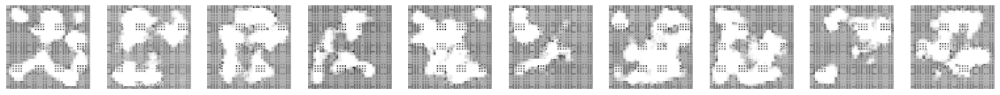

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 241/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7061 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_240.png


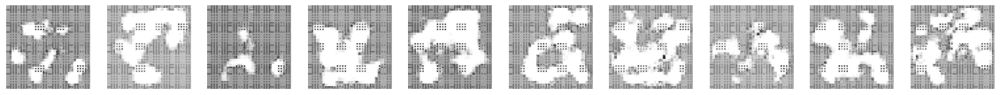

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7061 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 242/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7244 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_241.png


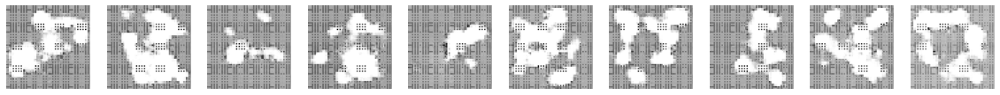

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7283 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 243/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7135 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_242.png


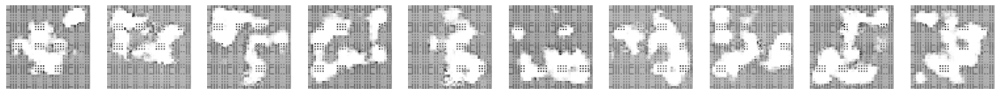

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7139 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 244/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7175 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_243.png


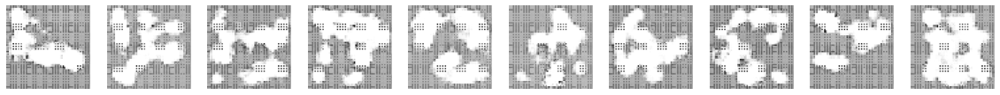

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7179 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 245/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7073 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_244.png


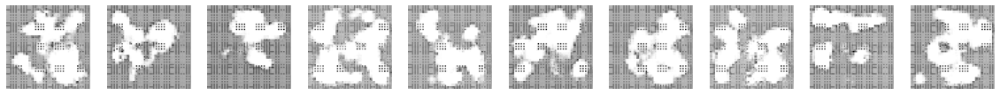

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7065 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 246/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7074 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_245.png


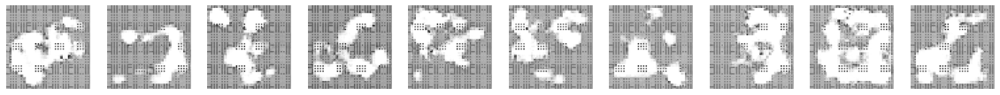

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7042 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 247/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7064 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_246.png


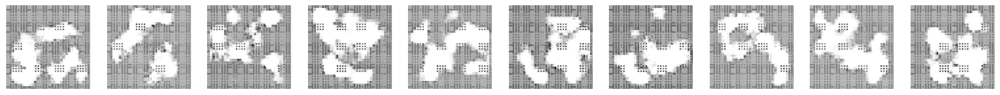

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7048 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 248/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7061 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_247.png


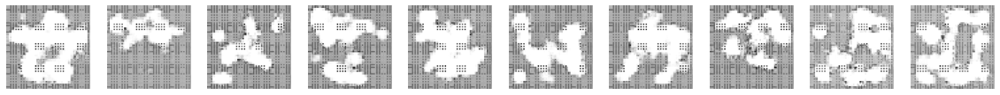

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7070 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 249/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7131 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_248.png


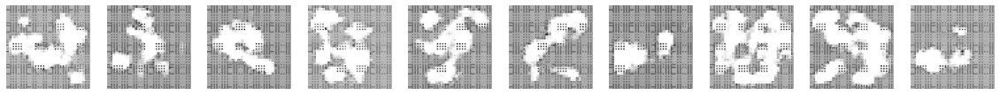

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7113 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 250/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7096 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_249.png


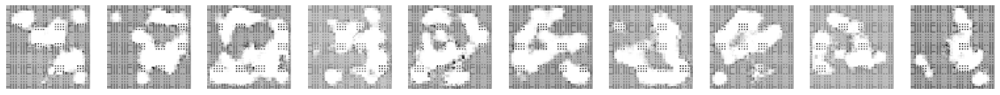

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7108 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 251/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7169 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_250.png


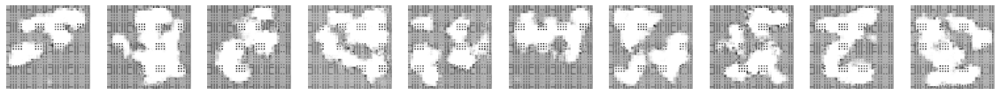

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7154 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 252/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7131 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_251.png


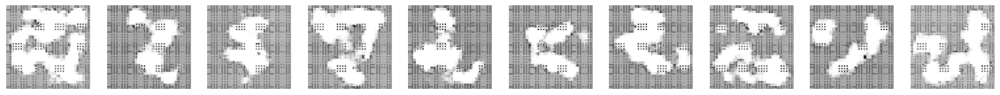

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7131 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 253/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7090 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_252.png


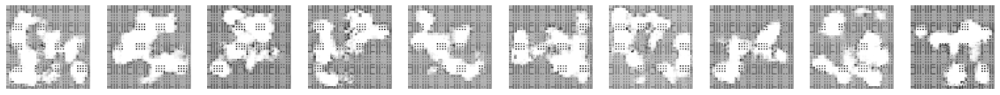

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7090 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 254/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7172 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_253.png


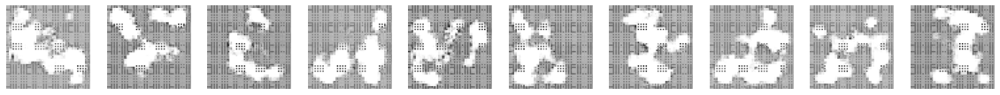

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7185 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 255/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7187 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_254.png


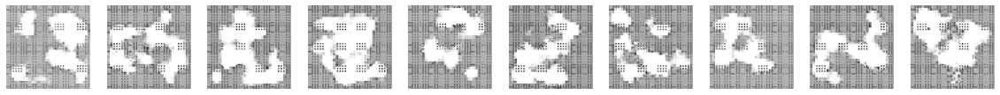

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7200 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 256/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7163 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_255.png


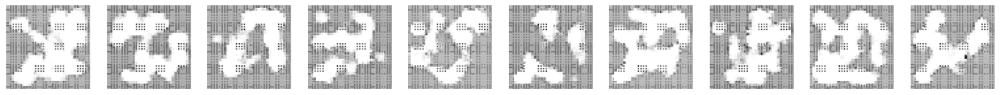

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7163 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 257/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7103 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_256.png


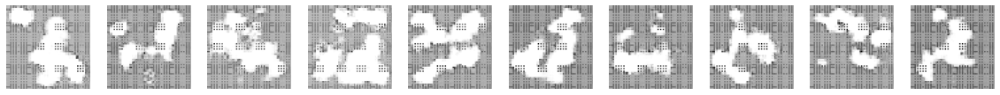

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7118 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 258/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7092 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_257.png


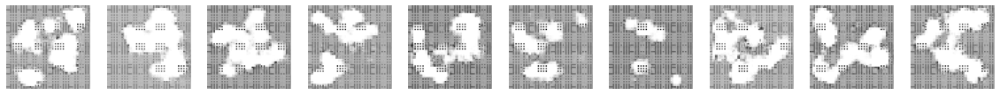

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7092 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 259/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7129 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_258.png


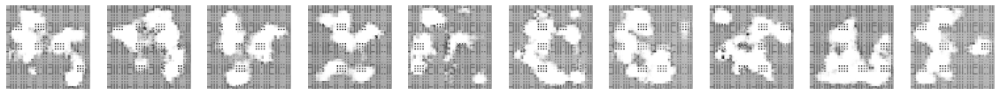

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7129 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 260/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7152 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_259.png


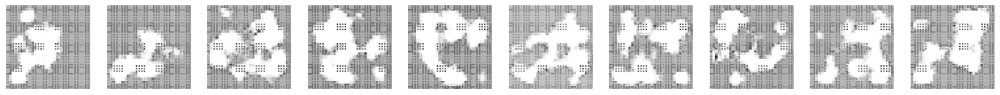

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7152 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 261/300
77/79 [============================>.] - ETA: 0s - d_loss: 7.7098 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_260.png


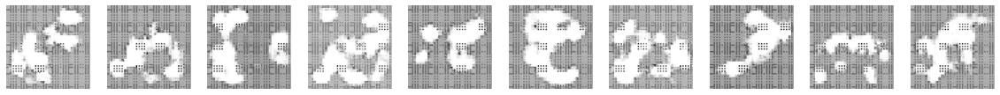

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7108 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 262/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7090 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_261.png


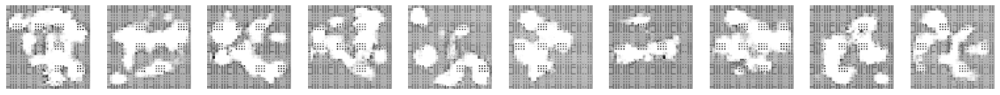

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7090 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 263/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7125 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_262.png


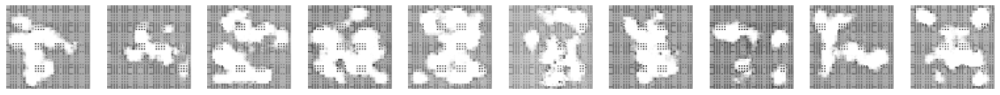

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7125 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 264/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7153 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_263.png


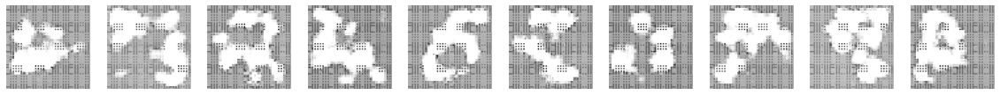

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7153 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 265/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7230 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_264.png


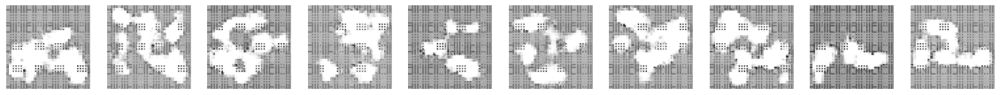

79/79 [==============================] - 5s 57ms/step - d_loss: 7.7230 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 266/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7130 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_265.png


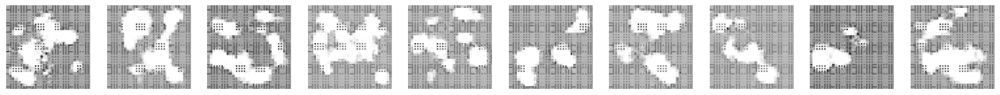

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7130 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 267/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7165 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_266.png


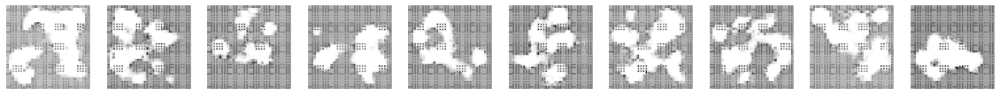

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7157 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 268/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7098 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_267.png


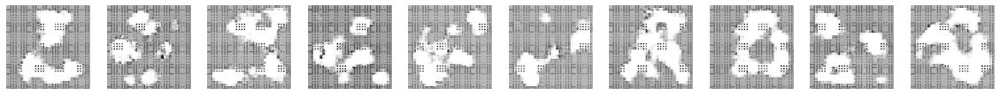

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7098 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 269/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7184 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_268.png


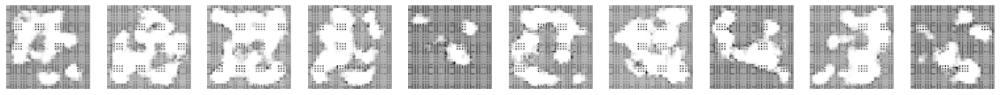

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7184 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 270/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7144 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_269.png


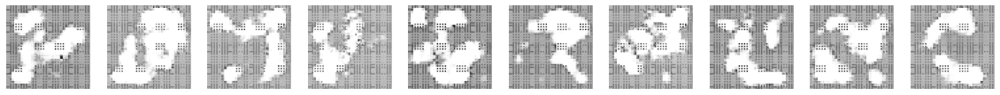

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7144 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 271/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7149 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_270.png


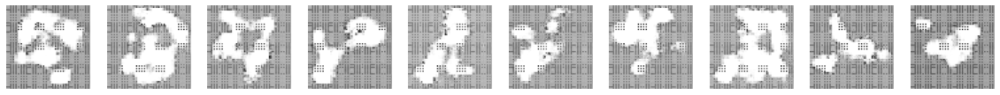

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7141 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 272/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7209 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_271.png


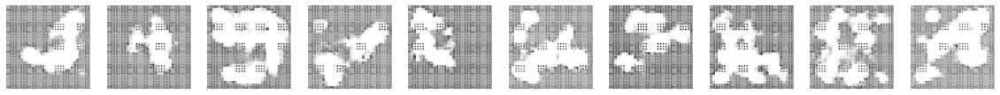

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7209 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 273/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7163 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_272.png


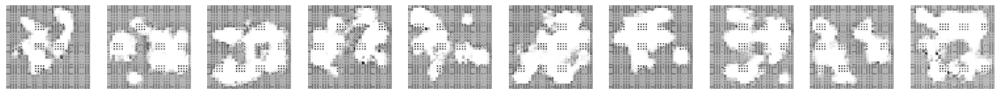

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7163 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 274/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_273.png


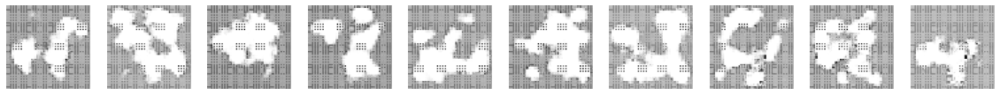

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7086 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 275/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7129 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_274.png


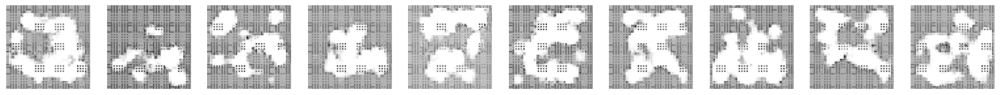

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7122 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 276/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7153 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_275.png


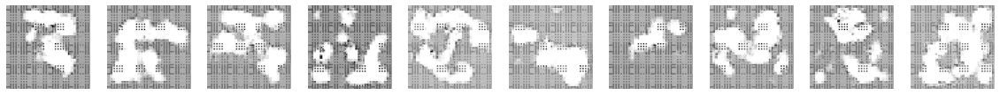

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7153 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 277/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7118 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_276.png


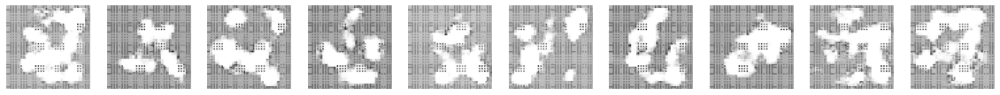

79/79 [==============================] - 5s 56ms/step - d_loss: 7.7108 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 278/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7097 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_277.png


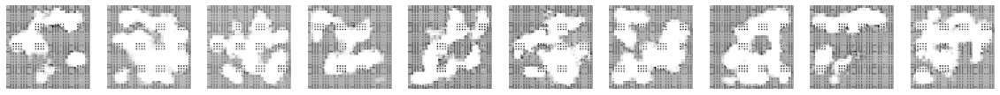

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7104 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 279/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7059 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_278.png


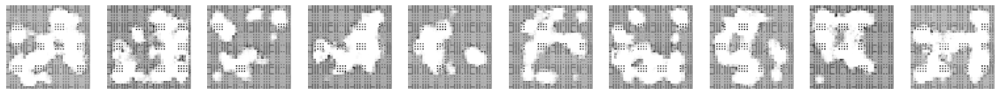

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7068 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 280/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7217 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_279.png


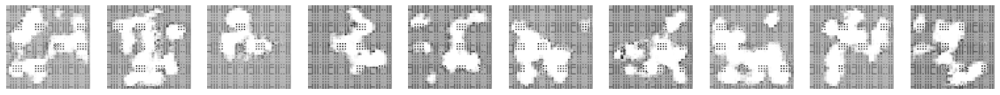

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7210 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 281/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7181 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_280.png


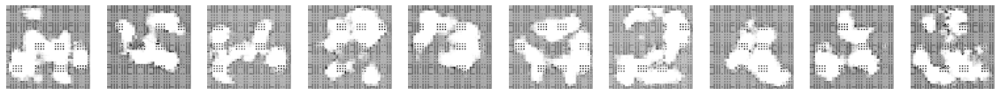

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7181 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 282/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7132 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_281.png


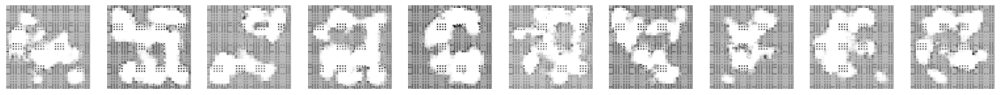

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7132 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 283/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7115 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_282.png


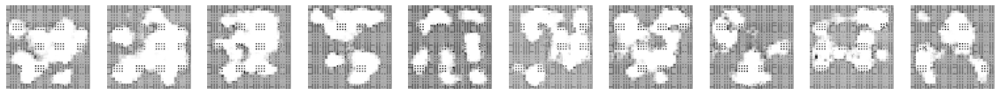

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7115 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 284/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7124 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_283.png


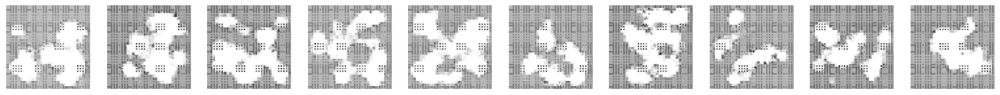

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7124 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 285/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7145 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_284.png


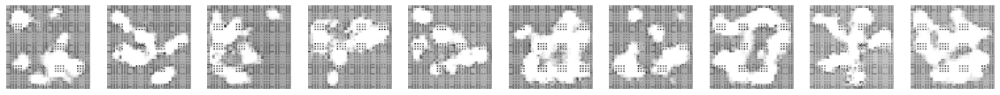

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7147 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 286/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7080 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_285.png


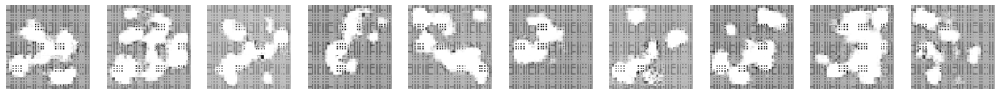

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7080 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 287/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7121 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_286.png


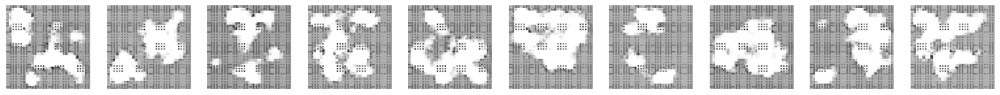

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7121 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 288/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7076 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_287.png


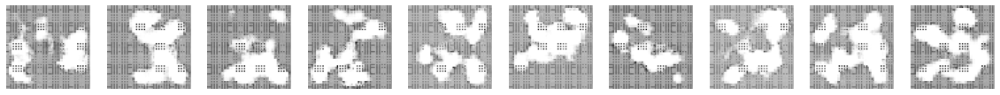

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7076 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 289/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7087 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_288.png


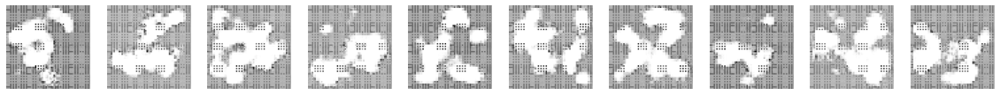

79/79 [==============================] - 5s 58ms/step - d_loss: 7.7108 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 290/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7134 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_289.png


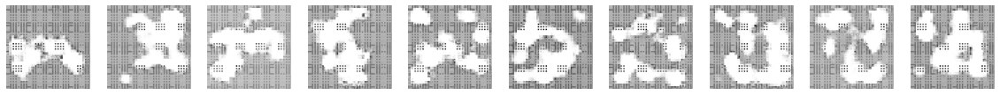

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7134 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 291/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7066 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_290.png


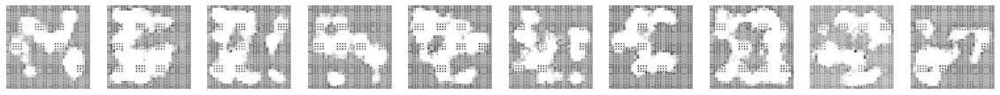

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7048 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 292/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7080 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_291.png


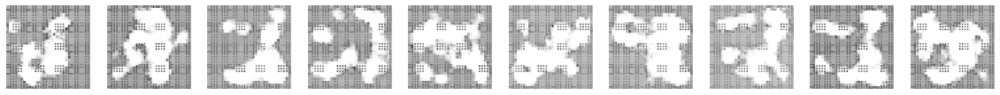

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7080 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 293/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7120 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_292.png


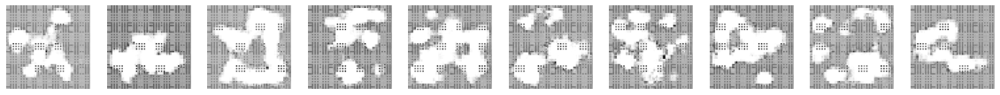

79/79 [==============================] - 4s 51ms/step - d_loss: 7.7120 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 294/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7131 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_293.png


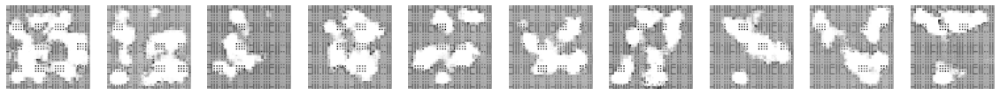

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7118 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 295/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7109 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_294.png


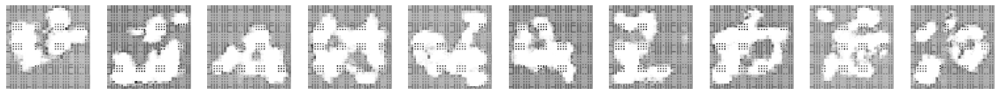

79/79 [==============================] - 4s 54ms/step - d_loss: 7.7110 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 296/300
79/79 [==============================] - ETA: 0s - d_loss: 7.7077 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_295.png


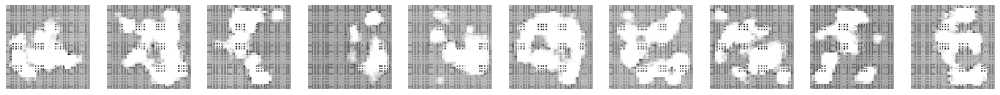

79/79 [==============================] - 4s 52ms/step - d_loss: 7.7077 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 297/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7150 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_296.png


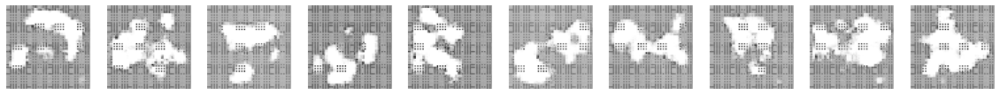

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7163 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 298/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7077 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_297.png


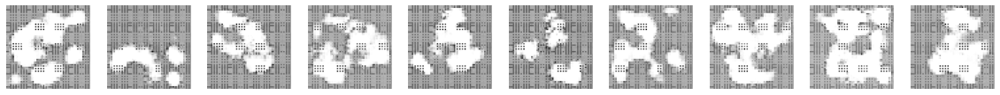

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7068 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 299/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7101 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_298.png


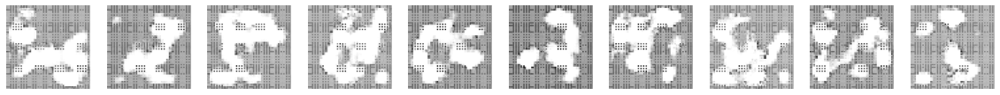

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7076 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Epoch 300/300
78/79 [============================>.] - ETA: 0s - d_loss: 7.7125 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00
Saved to output/generated_img_299.png


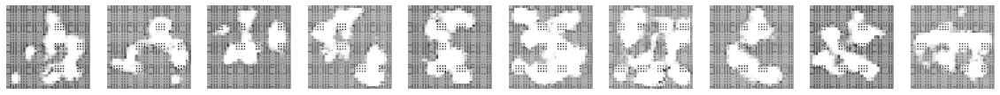

79/79 [==============================] - 4s 50ms/step - d_loss: 7.7146 - d_real_acc: 0.0000e+00 - d_fake_acc: 1.0000 - d_acc: 0.5000 - g_loss: 15.4249 - g_acc: 0.0000e+00


In [287]:
dcgan.fit(
    train,
    epochs=EPOCHS,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        ImageGenerator(num_img=10, latent_dim=Z_DIM),
    ],
)

In [288]:
# Save the final models
generator.save("./models/generator")
discriminator.save("./models/discriminator")

INFO:tensorflow:Assets written to: ./models/generator\assets


INFO:tensorflow:Assets written to: ./models/generator\assets


INFO:tensorflow:Assets written to: ./models/discriminator\assets


INFO:tensorflow:Assets written to: ./models/discriminator\assets


<h2> Generate new images </h2>

In [289]:
# Sample some points in the latent space, from the standard normal distribution
grid_width, grid_height = (10, 3)
z_sample = np.random.normal(size=(grid_width * grid_height, Z_DIM))

In [290]:
# Decode the sampled points
reconstructions = generator.predict(z_sample)

1/1 [==============================] - 1s 503ms/step


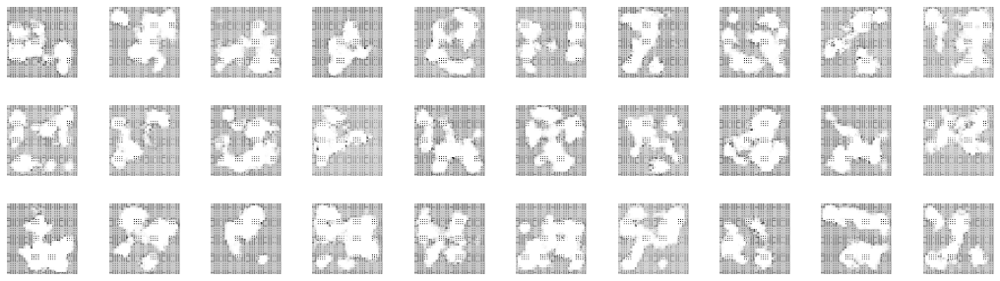

In [291]:
# Draw a plot of decoded images
fig = plt.figure(figsize=(18, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

# Output the grid of faces
for i in range(grid_width * grid_height):
    ax = fig.add_subplot(grid_height, grid_width, i + 1)
    ax.axis("off")
    ax.imshow(reconstructions[i, :, :], cmap="Greys")

In [292]:
def compare_images(img1, img2):
    return np.mean(np.abs(img1 - img2))

In [293]:
all_data = []
for i in train.as_numpy_iterator():
    all_data.extend(i)
all_data = np.array(all_data)

1/1 [==============================] - 0s 273ms/step


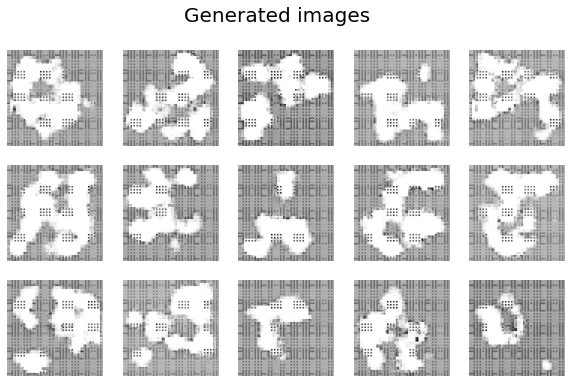

In [294]:
r, c = 3, 5
fig, axs = plt.subplots(r, c, figsize=(10, 6))
fig.suptitle("Generated images", fontsize=20)

noise = np.random.normal(size=(r * c, Z_DIM))
gen_imgs = generator.predict(noise)

cnt = 0
for i in range(r):
    for j in range(c):
        axs[i, j].imshow(gen_imgs[cnt], cmap="gray_r")
        axs[i, j].axis("off")
        cnt += 1

plt.show()

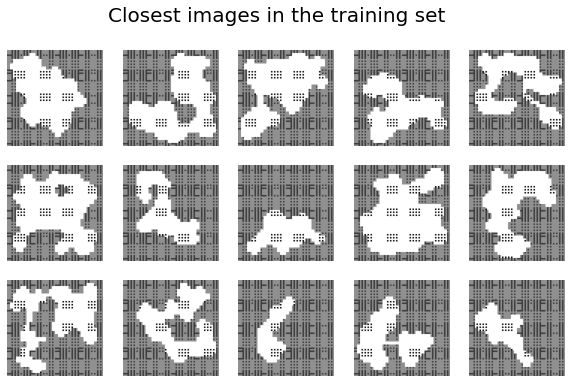

In [295]:
fig, axs = plt.subplots(r, c, figsize=(10, 6))
fig.suptitle("Closest images in the training set", fontsize=20)

cnt = 0
for i in range(r):
    for j in range(c):
        c_diff = 99999
        c_img = None
        for k_idx, k in enumerate(all_data):
            diff = compare_images(gen_imgs[cnt], k)
            if diff < c_diff:
                c_img = np.copy(k)
                c_diff = diff
        axs[i, j].imshow(c_img, cmap="gray_r")
        axs[i, j].axis("off")
        cnt += 1

plt.show()